In [3]:
using Pkg
Pkg.activate(@__DIR__)
Pkg.instantiate()

  Activating project at `c:\Users\Andreas\Dropbox\phd\Image_analysis\ColonyImages`


In [4]:
using Revise, CairoMakie
using ColonyImages
using DataFrames, CSV, FileIO, Dates, Serialization, Chain, DataFramesMeta
using Statistics, FFTW, FindPeaks1D, LsqFit
import ColorSchemes as co 

In [5]:
image_data = "data//metrics"
for (i,x) in enumerate(readdir(image_data))
    println(i,"  ",x)
end

1  128_col_3_15_fingers2024_04_23.csv
2  128_col_3_15_fingers2024_04_23.jls
3  64_col_3_15_fingers2024_04_23.csv
4  64_col_3_15_fingers2024_04_23.jls
5  64_col_3_30_fingers2024_04_22.csv
6  64_col_3_30_fingers2024_04_22.jls
7  64_col_3_8_fingers2024_04_23.csv
8  64_col_3_8_fingers2024_04_23.jls
9  8_col_3_15_fingers_test2024_08_13.csv
10  8_col_3_15_fingers_test2024_08_13.jls
11  data_sets_10_2023-09-26.csv
12  data_sets_10_2023-09-26.jls
13  data_sets_10_2024_04_16.csv
14  data_sets_10_2024_04_16.jls


In [6]:
data_a = deserialize(joinpath(image_data,readdir(image_data)[2]))
first(data_a,1)

Row,data_set,colony,time,metric_OG,metric_cov,pair_OG,pair_cov,OG_size,border_points,Parameters
,String,String,Int64,Array…,Array…,Array…,Array…,Int64,Array…,paramete…
1,Random 2024_04_23,Colony 1 artifical,0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0 … 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[63, 46, 59, 53, 58, 57, 57, 58, 56, 62 … 53, 62, 56, 58, 57, 57, 58, 53, 59, 63]","[5517, 5547, 5632, 5629, 5585, 5418, 5525, 5469, 5494, 5417 … 5578, 5489, 5521, 5323, 5490, 5575, 5712, 5578, 5523, 5565]","[5359, 5643, 5573, 5572, 5704, 5706, 5579, 5602, 5593, 5431 … 5666, 5453, 5689, 5521, 5384, 5440, 5529, 5642, 5668, 5451]",20589,"CartesianIndex{2}[CartesianIndex(788, 720), CartesianIndex(789, 720), CartesianIndex(790, 720), CartesianIndex(791, 720), CartesianIndex(792, 720), CartesianIndex(793, 720), CartesianIndex(794, 720), CartesianIndex(795, 720), CartesianIndex(796, 720), CartesianIndex(797, 720) … CartesianIndex(803, 880), CartesianIndex(804, 880), CartesianIndex(805, 880), CartesianIndex(806, 880), CartesianIndex(807, 880), CartesianIndex(808, 880), CartesianIndex(809, 880), CartesianIndex(810, 880), CartesianIndex(811, 880), CartesianIndex(812, 880)]","parameters([0.0, 2.0, 4.0, 6.0, 8.0, 10.0, 12.0, 14.0, 16.0, 18.0 … 34.0, 36.0, 38.0, 40.0, 42.0, 44.0, 46.0, 48.0, 50.0, 52.0], 0.8, 0.8, 0.4, 360, 2000000, 300, [1600, 1600], 27, 80, [800, 800], [0.0297605, 0.0, 0.0, 0.0], #5, 0.01, [0 1 0; 1 -4 1; 0 1 0], 128, [""Colony 1 artifical"", ""Colony 2 artifical"", ""Colony 3 artifical"", ""Colony 4 artifical"", ""Colony 5 artifical"", ""Colony 6 artifical"", ""Colony 7 artifical"", ""Colony 8 artifical"", ""Colony 9 artifical"", ""Colony 10 artifical"" … ""Colony 119 artifical"", ""Colony 120 artifical"", ""Colony 121 artifical"", ""Colony 122 artifical"", ""Colony 123 artifical"", ""Colony 124 artifical"", ""Colony 125 artifical"", ""Colony 126 artifical"", ""Colony 127 artifical"", ""Colony 128 artifical""], 2.0, [0.0, 0.0604066, 0.124462, 0.192387, 0.264415, 0.340794, 0.421787, 0.507672, 0.598745, 0.69532 … 1.71039, 1.87411, 2.04773, 2.23183, 2.42705, 2.63407, 2.85359, 3.08637, 3.33322, 3.59497], [0.0604066, 0.0640555, 0.0679249, 0.072028, 0.076379, 0.0809928, 0.0858853, 0.0910733, 0.0965748, 0.102409 … 0.154398, 0.163725, 0.173615, 0.184103, 0.195224, 0.207017, 0.219522, 0.232782, 0.246844, 0.261755], 15, 0.1, #7, 0.2, 0.999, 0.999)"


In [7]:
data_a_30 = deserialize(joinpath(image_data,readdir(image_data)[6]))
first(data_a_30,1)

Row,data_set,colony,time,metric_OG,metric_cov,pair_OG,pair_cov,OG_size,border_points,Parameters
,String,String,Int64,Array…,Array…,Array…,Array…,Int64,Array…,paramete…
1,Random 2024_04_22,Colony 1 artifical,0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0 … 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[63, 46, 59, 53, 58, 57, 57, 58, 56, 62 … 53, 62, 56, 58, 57, 57, 58, 53, 59, 63]","[5443, 5570, 5467, 5536, 5484, 5555, 5431, 5697, 5494, 5519 … 5548, 5532, 5499, 5658, 5518, 5499, 5580, 5437, 5433, 5541]","[5489, 5618, 5484, 5657, 5504, 5517, 5657, 5514, 5533, 5465 … 5456, 5527, 5606, 5472, 5432, 5508, 5506, 5620, 5473, 5602]",20589,"CartesianIndex{2}[CartesianIndex(788, 720), CartesianIndex(789, 720), CartesianIndex(790, 720), CartesianIndex(791, 720), CartesianIndex(792, 720), CartesianIndex(793, 720), CartesianIndex(794, 720), CartesianIndex(795, 720), CartesianIndex(796, 720), CartesianIndex(797, 720) … CartesianIndex(803, 880), CartesianIndex(804, 880), CartesianIndex(805, 880), CartesianIndex(806, 880), CartesianIndex(807, 880), CartesianIndex(808, 880), CartesianIndex(809, 880), CartesianIndex(810, 880), CartesianIndex(811, 880), CartesianIndex(812, 880)]","parameters([0.0, 2.0, 4.0, 6.0, 8.0, 10.0, 12.0, 14.0, 16.0, 18.0 … 34.0, 36.0, 38.0, 40.0, 42.0, 44.0, 46.0, 48.0, 50.0, 52.0], 0.8, 0.8, 0.4, 360, 2000000, 300, [1600, 1600], 27, 80, [800, 800], [0.0337, 2.9533, 0.7979, 17.5799], #5, 0.01, [0 1 0; 1 -4 1; 0 1 0], 64, [""Colony 1 artifical"", ""Colony 2 artifical"", ""Colony 3 artifical"", ""Colony 4 artifical"", ""Colony 5 artifical"", ""Colony 6 artifical"", ""Colony 7 artifical"", ""Colony 8 artifical"", ""Colony 9 artifical"", ""Colony 10 artifical"" … ""Colony 55 artifical"", ""Colony 56 artifical"", ""Colony 57 artifical"", ""Colony 58 artifical"", ""Colony 59 artifical"", ""Colony 60 artifical"", ""Colony 61 artifical"", ""Colony 62 artifical"", ""Colony 63 artifical"", ""Colony 64 artifical""], 2.0, [2.39033e-6, 0.0685475, 0.141827, 0.220307, 0.305049, 0.399942, 0.522468, 0.750978, 1.35176, 2.53778 … 5.03942, 5.25093, 5.47694, 5.71844, 5.97648, 6.25221, 6.54684, 6.86166, 7.19806, 7.55752], [0.0685451, 0.0732792, 0.0784805, 0.0847421, 0.0948925, 0.122526, 0.22851, 0.600784, 1.18602, 0.981907 … 0.197967, 0.211515, 0.226007, 0.241495, 0.258046, 0.275732, 0.294629, 0.314822, 0.336398, 0.359453], 30, 0.1, #7, 0.1, 0.9995, 0.9995)"


In [8]:
data_a_8 = deserialize(joinpath(image_data,readdir(image_data)[8]))
first(data_a_8,1)

Row,data_set,colony,time,metric_OG,metric_cov,pair_OG,pair_cov,OG_size,border_points,Parameters
,String,String,Int64,Array…,Array…,Array…,Array…,Int64,Array…,paramete…
1,Random 2024_04_23,Colony 1 artifical,0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0 … 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[63, 46, 59, 53, 58, 57, 57, 58, 56, 62 … 53, 62, 56, 58, 57, 57, 58, 53, 59, 63]","[5479, 5444, 5557, 5624, 5580, 5448, 5510, 5552, 5463, 5663 … 5543, 5618, 5722, 5491, 5632, 5524, 5583, 5574, 5487, 5536]","[5454, 5522, 5637, 5438, 5557, 5451, 5546, 5582, 5587, 5536 … 5613, 5473, 5502, 5487, 5429, 5487, 5596, 5646, 5584, 5463]",20589,"CartesianIndex{2}[CartesianIndex(788, 720), CartesianIndex(789, 720), CartesianIndex(790, 720), CartesianIndex(791, 720), CartesianIndex(792, 720), CartesianIndex(793, 720), CartesianIndex(794, 720), CartesianIndex(795, 720), CartesianIndex(796, 720), CartesianIndex(797, 720) … CartesianIndex(803, 880), CartesianIndex(804, 880), CartesianIndex(805, 880), CartesianIndex(806, 880), CartesianIndex(807, 880), CartesianIndex(808, 880), CartesianIndex(809, 880), CartesianIndex(810, 880), CartesianIndex(811, 880), CartesianIndex(812, 880)]","parameters([0.0, 2.0, 4.0, 6.0, 8.0, 10.0, 12.0, 14.0, 16.0, 18.0 … 34.0, 36.0, 38.0, 40.0, 42.0, 44.0, 46.0, 48.0, 50.0, 52.0], 0.8, 0.8, 0.4, 360, 2000000, 300, [1600, 1600], 27, 80, [800, 800], [0.0297605, 0.0, 0.0, 0.0], #5, 0.01, [0 1 0; 1 -4 1; 0 1 0], 64, [""Colony 1 artifical"", ""Colony 2 artifical"", ""Colony 3 artifical"", ""Colony 4 artifical"", ""Colony 5 artifical"", ""Colony 6 artifical"", ""Colony 7 artifical"", ""Colony 8 artifical"", ""Colony 9 artifical"", ""Colony 10 artifical"" … ""Colony 55 artifical"", ""Colony 56 artifical"", ""Colony 57 artifical"", ""Colony 58 artifical"", ""Colony 59 artifical"", ""Colony 60 artifical"", ""Colony 61 artifical"", ""Colony 62 artifical"", ""Colony 63 artifical"", ""Colony 64 artifical""], 2.0, [0.0, 0.0604066, 0.124462, 0.192387, 0.264415, 0.340794, 0.421787, 0.507672, 0.598745, 0.69532 … 1.71039, 1.87411, 2.04773, 2.23183, 2.42705, 2.63407, 2.85359, 3.08637, 3.33322, 3.59497], [0.0604066, 0.0640555, 0.0679249, 0.072028, 0.076379, 0.0809928, 0.0858853, 0.0910733, 0.0965748, 0.102409 … 0.154398, 0.163725, 0.173615, 0.184103, 0.195224, 0.207017, 0.219522, 0.232782, 0.246844, 0.261755], 8, 0.1, #7, 0.2, 0.995, 0.995)"


In [9]:
data_r = deserialize(joinpath(image_data,readdir(image_data)[end]))
first(data_r,1)

Row,data_set,colony,time,metric_OG,metric_cov,pair_OG,pair_cov,OG_size,border_points,Parameters
,String,String,Int64,Array…,Array…,Array…,Array…,Int64,Array…,paramete…
1,10_04_23_stacked_half_res 2024_04_16,Kolonie 1.tif,0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0 … 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[16, 0, 9, 6, 10, 7, 10, 8, 9, 10 … 7, 10, 9, 8, 10, 7, 10, 6, 9, 16]","[5702, 4707, 5277, 5701, 5619, 5476, 5485, 5498, 5869, 5366 … 5458, 5857, 5628, 5512, 5554, 5558, 5920, 5346, 4664, 6433]","[5727, 4594, 5200, 5573, 5727, 5404, 5659, 5419, 5819, 5432 … 5301, 5699, 5597, 5677, 5464, 5710, 5799, 5233, 4801, 6400]",2992,"CartesianIndex{2}[CartesianIndex(135, 131), CartesianIndex(136, 131), CartesianIndex(137, 131), CartesianIndex(138, 131), CartesianIndex(139, 131), CartesianIndex(140, 131), CartesianIndex(141, 131), CartesianIndex(142, 131), CartesianIndex(143, 131), CartesianIndex(131, 132) … CartesianIndex(146, 191), CartesianIndex(147, 191), CartesianIndex(135, 192), CartesianIndex(136, 192), CartesianIndex(137, 192), CartesianIndex(138, 192), CartesianIndex(139, 192), CartesianIndex(140, 192), CartesianIndex(141, 192), CartesianIndex(142, 192)]","parameters([0.0, 24.0, 48.0], 0.8, 0.8, 0.4, 360, 2000000, 300, [318, 324], 3, 16, [159, 162], 0.029717, #5, 0.01, [0 1 0; 1 -4 1; 0 1 0], 8, [""Kolonie 1.tif"", ""Kolonie 2.tif"", ""Kolonie 3.tif"", ""Kolonie 4.tif"", ""Kolonie 5.tif"", ""Kolonie 6.tif"", ""Kolonie 7.tif"", ""Kolonie 8.tif""], 2.0, [0.0, 1.01943, 3.07811], [1.01943, 2.05867], 15, 0.1, #7, 0.2, 0.995, 0.995)"


In [10]:
data_full = filter(row -> row.data_set[end-18:end-11] =="full_res", data_r )
unique(data_full.data_set)

4-element Vector{String}:
 "14_06_23_stacked_full_res 2024_04_16"
 "17_05_23_stacked_full_res 2024_04_16"
 "19_12_22_stacked_full_res 2024_04_16"
 "26_06_23_stacked_full_res 2024_04_16"

In [11]:
data_evo_all = filter(row -> row.data_set[end-23:end-11] =="full_res_expo", data_r )
unique(data_evo_all.colony)

6-element Vector{String}:
 "Kolonie-1 seg manuell.tif"
 "Kolonie-2 seg manuell.tif"
 "Kolonie-3 seg manuell.tif"
 "Kolonie-4 seg manuell.tif"
 "Kolonie-5 seg manuell.tif"
 "Kolonie-6 seg manuell.tif"

In [12]:
data_evo_active = filter(row -> row.colony =="Kolonie-1 seg manuell.tif" || row.colony == "Kolonie-4 seg manuell.tif", data_evo_all )
data_evo_passive = antijoin(data_evo_all, data_evo_active, on = :colony)
unique(data_evo_active.colony)

2-element Vector{String}:
 "Kolonie-1 seg manuell.tif"
 "Kolonie-4 seg manuell.tif"

In [13]:
path = "analysis\\comparison"
mkpath(path)

ana_para = analysis_parameters(plot_theme =
    Theme(  fontsize = 30,
    size = (1000,800),
    Scatter = (markersize = 18,
    label = "Exp 1",),                
    Lines  = (linewidth =4,),
    Errorbars = (whiskerwidth = 20, 
    color = :black)
    ))
update_theme!(ana_para.plot_theme)

In [14]:
first(data_a,2) 

Row,data_set,colony,time,metric_OG,metric_cov,pair_OG,pair_cov,OG_size,border_points,Parameters
,String,String,Int64,Array…,Array…,Array…,Array…,Int64,Array…,paramete…
1,Random 2024_04_23,Colony 1 artifical,0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0 … 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[63, 46, 59, 53, 58, 57, 57, 58, 56, 62 … 53, 62, 56, 58, 57, 57, 58, 53, 59, 63]","[5517, 5547, 5632, 5629, 5585, 5418, 5525, 5469, 5494, 5417 … 5578, 5489, 5521, 5323, 5490, 5575, 5712, 5578, 5523, 5565]","[5359, 5643, 5573, 5572, 5704, 5706, 5579, 5602, 5593, 5431 … 5666, 5453, 5689, 5521, 5384, 5440, 5529, 5642, 5668, 5451]",20589,"CartesianIndex{2}[CartesianIndex(788, 720), CartesianIndex(789, 720), CartesianIndex(790, 720), CartesianIndex(791, 720), CartesianIndex(792, 720), CartesianIndex(793, 720), CartesianIndex(794, 720), CartesianIndex(795, 720), CartesianIndex(796, 720), CartesianIndex(797, 720) … CartesianIndex(803, 880), CartesianIndex(804, 880), CartesianIndex(805, 880), CartesianIndex(806, 880), CartesianIndex(807, 880), CartesianIndex(808, 880), CartesianIndex(809, 880), CartesianIndex(810, 880), CartesianIndex(811, 880), CartesianIndex(812, 880)]","parameters([0.0, 2.0, 4.0, 6.0, 8.0, 10.0, 12.0, 14.0, 16.0, 18.0 … 34.0, 36.0, 38.0, 40.0, 42.0, 44.0, 46.0, 48.0, 50.0, 52.0], 0.8, 0.8, 0.4, 360, 2000000, 300, [1600, 1600], 27, 80, [800, 800], [0.0297605, 0.0, 0.0, 0.0], #5, 0.01, [0 1 0; 1 -4 1; 0 1 0], 128, [""Colony 1 artifical"", ""Colony 2 artifical"", ""Colony 3 artifical"", ""Colony 4 artifical"", ""Colony 5 artifical"", ""Colony 6 artifical"", ""Colony 7 artifical"", ""Colony 8 artifical"", ""Colony 9 artifical"", ""Colony 10 artifical"" … ""Colony 119 artifical"", ""Colony 120 artifical"", ""Colony 121 artifical"", ""Colony 122 artifical"", ""Colony 123 artifical"", ""Colony 124 artifical"", ""Colony 125 artifical"", ""Colony 126 artifical"", ""Colony 127 artifical"", ""Colony 128 artifical""], 2.0, [0.0, 0.0604066, 0.124462, 0.192387, 0.264415, 0.340794, 0.421787, 0.507672, 0.598745, 0.69532 … 1.71039, 1.87411, 2.04773, 2.23183, 2.42705, 2.63407, 2.85359, 3.08637, 3.33322, 3.59497], [0.0604066, 0.0640555, 0.0679249, 0.072028, 0.076379, 0.0809928, 0.0858853, 0.0910733, 0.0965748, 0.102409 … 0.154398, 0.163725, 0.173615, 0.184103, 0.195224, 0.207017, 0.219522, 0.232782, 0.246844, 0.261755], 15, 0.1, #7, 0.2, 0.999, 0.999)"
2,Random 2024_04_23,Colony 1 artifical,2,"[4, 7, 1, 3, 3, 2, 3, 4, 3, 3 … 4, 2, 5, 2, 4, 5, 4, 5, 1, 4]","[4, 5, 1, 0, 0, 0, 3, 2, 1, 1 … 1, 0, 1, 0, 2, 3, 1, 2, 1, 4]","[4725, 7321, 5842, 5284, 5950, 6301, 5356, 4966, 6257, 5744 … 5877, 6394, 4987, 5337, 6117, 5807, 4830, 5261, 6631, 5117]","[4337, 8146, 5830, 5418, 6131, 5798, 6217, 4109, 5984, 6294 … 6459, 6046, 4338, 6206, 5296, 6004, 4497, 5581, 6121, 4992]",20589,"CartesianIndex{2}[CartesianIndex(800, 714), CartesianIndex(799, 715), CartesianIndex(800, 715), CartesianIndex(790, 716), CartesianIndex(799, 716), CartesianIndex(800, 716), CartesianIndex(804, 716), CartesianIndex(807, 716), CartesianIndex(808, 716), CartesianIndex(783, 717) … CartesianIndex(817, 883), CartesianIndex(819, 883), CartesianIndex(820, 883), CartesianIndex(791, 884), CartesianIndex(794, 884), CartesianIndex(796, 884), CartesianIndex(800, 884), CartesianIndex(801, 884), CartesianIndex(815, 884), CartesianIndex(795, 885)]","parameters([0.0, 2.0, 4.0, 6.0, 8.0, 10.0, 12.0, 14.0, 16.0, 18.0 … 34.0, 36.0, 38.0, 40.0, 42.0, 44.0, 46.0, 48.0, 50.0, 52.0], 0.8, 0.8, 0.4, 360, 2000000, 300, [1600, 1600], 27, 80, [800, 800], [0.0297605, 0.0, 0.0, 0.0], #5, 0.01, [0 1 0; 1 -4 1; 0 1 0], 128, [""Colony 1 artifical"", ""Colony 2 artifical"", ""Colony 3 artifical"", ""Colony 4 artifical"", ""Colony 5 artifical"", ""Colony 6 artifical"", ""Colony 7 artifical"", ""Colony 8 artifical"", ""Colony 9 artifical"", ""Colony 10 artifical"" … ""Colony 119 artifical"", ""Colony 120 artifical"", ""Colony 121 artifical"", ""Colony 122 artifical"", ""Colony 123 artifical"", ""Colony 124 artifical"", ""Colony 125 ar

In [15]:
data_evo_active_sum = @chain data_evo_active begin 
    groupby(:time)
    @combine(:metric_OG = [mean(:metric_OG)], :metric_cov = [mean(:metric_cov)], :pair_OG = [mean(:pair_OG)], :pair_cov = [mean(:pair_cov)])
end

data_evo_passive_sum = @chain data_evo_passive begin 
    groupby(:time)
    @combine(:metric_OG = [mean(:metric_OG)], :metric_cov = [mean(:metric_cov)], :pair_OG = [mean(:pair_OG)], :pair_cov = [mean(:pair_cov)])
end
 data_evo_active_sum

Row,time,metric_OG,metric_cov,pair_OG,pair_cov
,Int64,Array…,Array…,Array…,Array…
1,0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0 … 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]","[174.0, 161.5, 167.0, 170.0, 173.0, 175.0, 176.5, 174.5, 171.0, 176.0 … 164.0, 175.0, 171.5, 175.5, 176.0, 176.0, 174.0, 172.5, 169.5, 174.0]","[5577.5, 5635.5, 5613.0, 5571.0, 5592.5, 5601.5, 5669.5, 5514.0, 5531.0, 5556.5 … 5567.0, 5555.5, 5547.0, 5568.0, 5427.0, 5509.0, 5659.5, 5579.0, 5511.0, 5567.5]","[5529.5, 5583.5, 5491.0, 5553.5, 5579.5, 5578.5, 5628.0, 5594.0, 5448.0, 5613.5 … 5585.5, 5552.0, 5498.5, 5552.0, 5610.5, 5577.0, 5597.0, 5522.0, 5582.0, 5508.0]"
2,20,"[173.0, 166.0, 166.5, 172.0, 175.0, 179.5, 186.5, 191.0, 193.5, 190.5 … 157.5, 160.0, 170.5, 175.0, 180.0, 180.0, 181.5, 177.0, 177.0, 173.0]","[36.0, 37.0, 32.0, 42.0, 47.5, 55.5, 62.0, 66.5, 66.0, 65.5 … 26.5, 29.5, 34.5, 42.0, 48.0, 49.5, 48.0, 45.0, 42.0, 36.0]","[8327.0, 8208.5, 7944.0, 7712.0, 7493.5, 7053.0, 6719.5, 6511.5, 6225.0, 5853.0 … 5128.5, 5090.0, 5144.5, 5200.5, 5125.5, 5165.0, 5105.0, 5089.5, 5040.5, 5088.0]","[9417.5, 9238.0, 9015.5, 8660.0, 8223.5, 7730.0, 7334.0, 6818.5, 6419.0, 5983.5 … 5168.0, 5315.5, 5200.0, 5273.0, 5345.5, 5443.5, 5490.5, 5481.0, 5591.0, 5551.5]"
3,24,"[168.0, 165.0, 164.0, 169.0, 171.0, 176.5, 180.5, 185.5, 188.5, 185.0 … 158.0, 157.0, 165.5, 171.0, 174.0, 170.0, 171.0, 168.5, 166.5, 168.0]","[30.0, 34.5, 28.5, 38.0, 42.0, 51.5, 55.0, 60.0, 59.0, 59.0 … 28.0, 29.5, 31.0, 37.0, 40.5, 38.5, 36.0, 35.0, 30.0, 30.0]","[8749.5, 8666.0, 8256.5, 8051.0, 7662.5, 7405.0, 6934.0, 6569.5, 6251.0, 5960.0 … 5144.5, 5171.0, 5191.0, 5124.0, 5172.5, 5129.0, 5024.5, 5061.0, 5001.0, 5151.0]","[9642.0, 9480.5, 9182.5, 8816.0, 8342.5, 7920.0, 7537.0, 7039.0, 6515.5, 6099.0 … 5107.0, 5259.5, 5227.0, 5411.0, 5496.5, 5416.0, 5537.5, 5542.5, 5651.0, 5612.5]"
4,44,"[66.0, 59.0, 66.5, 67.0, 72.0, 72.5, 73.0, 77.0, 70.0, 65.0 … 93.5, 87.5, 80.0, 68.0, 68.0, 69.5, 70.5, 63.5, 70.5, 66.0]","[23.0, 28.5, 31.5, 31.5, 33.5, 33.5, 29.5, 26.5, 18.0, 13.5 … 40.0, 39.5, 33.5, 26.5, 28.0, 24.5, 26.0, 21.5, 17.0, 23.0]","[9972.5, 9891.5, 9543.0, 9136.0, 8655.0, 8164.0, 7785.5, 7217.0, 6746.0, 6372.0 … 4789.0, 4747.5, 4867.5, 4811.0, 4881.5, 4789.0, 4862.0, 4936.5, 4877.5, 5024.0]","[9638.5, 9469.0, 9070.5, 8883.5, 8403.5, 7963.5, 7688.0, 7204.0, 6934.0, 6514.5 … 5344.0, 5463.5, 5455.0, 5607.0, 5537.5, 5706.0, 5652.5, 5686.5, 5782.5, 5879.5]"


## Measurement of anistropy 

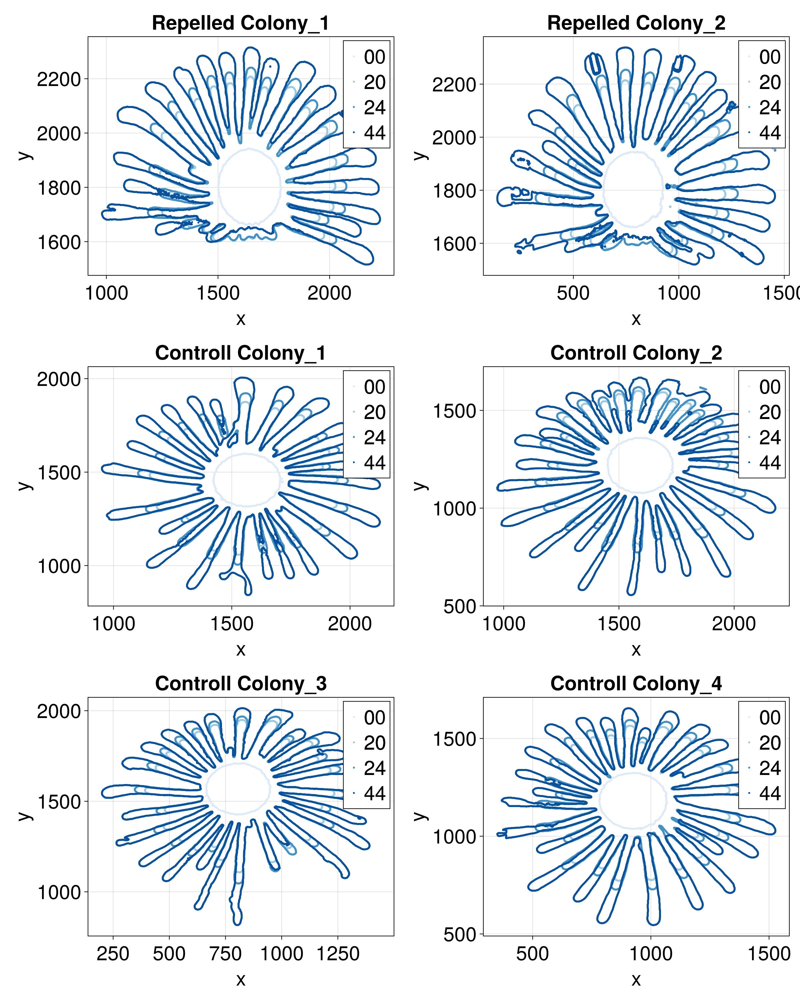

In [16]:
fig_contour = Figure(size = (1200,1500))
j =0
for (k, i) in pairs(groupby(data_evo_active,:colony))
    ax = Axis(fig_contour[1,j+1], xlabel = "x", ylabel = "y", title = "Repelled Colony_$(j+1)")
    for l in 1:length(i.time)
        scatter!(ax,Point2f.(Tuple.(i.border_points[l])), markersize = 4, color = co.Blues[l*2],label = "$(i.time[l])")
        axislegend(ax)
    end
    j += 1
end
for (k, i) in pairs(groupby(data_evo_passive,:colony))
    ax = Axis(fig_contour[j÷2+1,(j%2)+1], xlabel = "x", ylabel = "y", title = "Controll Colony_$(j+-1)")
    for l in 1:length(i.time)
        scatter!(ax,Point2f.(Tuple.(i.border_points[l])), markersize = 4, color = co.Blues[l*2], label = "$(i.time[l])")
        axislegend(ax)
    end
    j += 1
end

fig_contour

In [17]:
mean(data_evo_active_sum.pair_OG[1])

5555.555555555556

In [18]:
length(data_evo_active_sum.pair_OG[1])  

360

In [19]:
x = collect(LinRange(0, 180, 360))

360-element Vector{Float64}:
   0.0
   0.5013927576601671
   1.0027855153203342
   1.5041782729805016
   2.0055710306406684
   2.5069637883008355
   3.008356545961003
   3.50974930362117
   4.011142061281337
   4.512534818941504
   ⋮
 175.98885793871867
 176.49025069637884
 176.991643454039
 177.49303621169915
 177.99442896935932
 178.4958217270195
 178.99721448467966
 179.49860724233983
 180.0

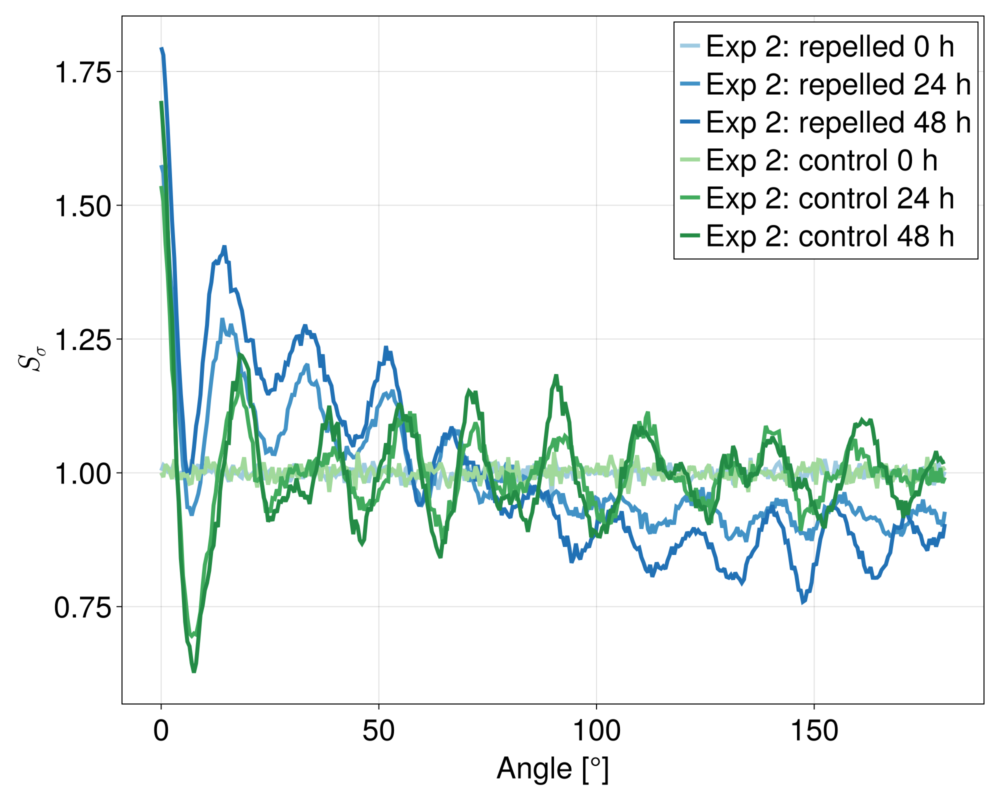

In [20]:
times = ["0 h", "20 h","24 h", "48 h"]
fig_s3 = Figure(size = (1000,800))
ax3 = Axis(fig_s3[1,1], xlabel = "Angle [°]", ylabel = L"S_{\sigma}")
off_data = Int(length(data_a.time)/3)
sim_type = 2
offset = 0
x = collect(LinRange(0, 180, 360))
for i in 1:length(data_evo_active_sum.time)
    if i == 2
        continue
    end
    lines!(ax3, x,data_evo_active_sum.pair_OG[i]./5555, label = "Exp 2: repelled $(times[i])", color = co.Blues[i+3])
end

for i in 1:length(data_evo_passive_sum.time)
    if i == 2
        continue
    end
    lines!(ax3,x, data_evo_passive.pair_OG[i]./5555, label = "Exp 2: control $(times[i])", color = color = co.Greens[i+3])
end


axislegend(ax3)   

save(joinpath(path,"aniso1.pdf"),fig_s3)

fig_s3

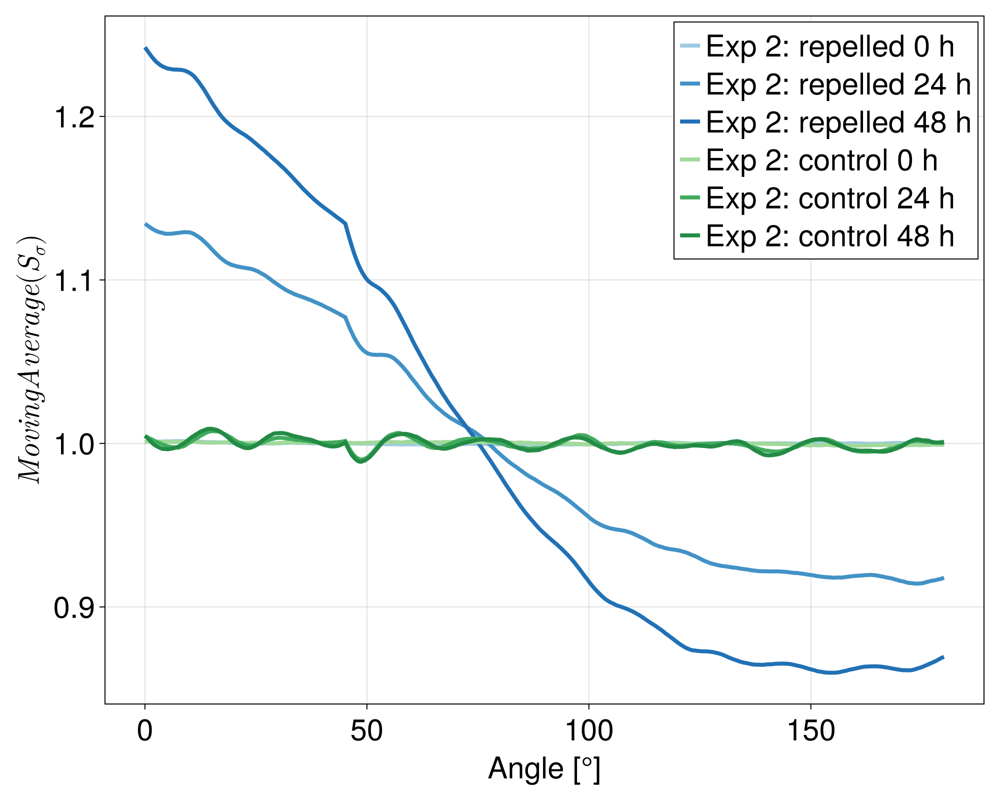

In [21]:
fig_s3 = Figure(size = (1000,800))
ax3 = Axis(fig_s3[1,1], xlabel = "Angle [°]", ylabel = L"Moving Average(S_{\sigma})")
off_data = Int(length(data_a.time)/3)
sim_type = 2
offset = 0

for i in 1:length(data_evo_active_sum.time)
    if i == 2
        continue
    end
    lines!(ax3,x, moving_avg(data_evo_active_sum.pair_OG[i]./5555,180), label = "Exp 2: repelled $(times[i])", color = co.Blues[i+3])
end

for i in 1:length(data_evo_passive_sum.time)
    if i == 2
        continue
    end
    lines!(ax3,x, moving_avg(data_evo_passive.pair_OG[i]./5555,180), label = "Exp 2: control $(times[i])", color = color = co.Greens[i+3])
end


axislegend(ax3)   

save(joinpath(path,"aniso2.pdf"),fig_s3)
fig_s3

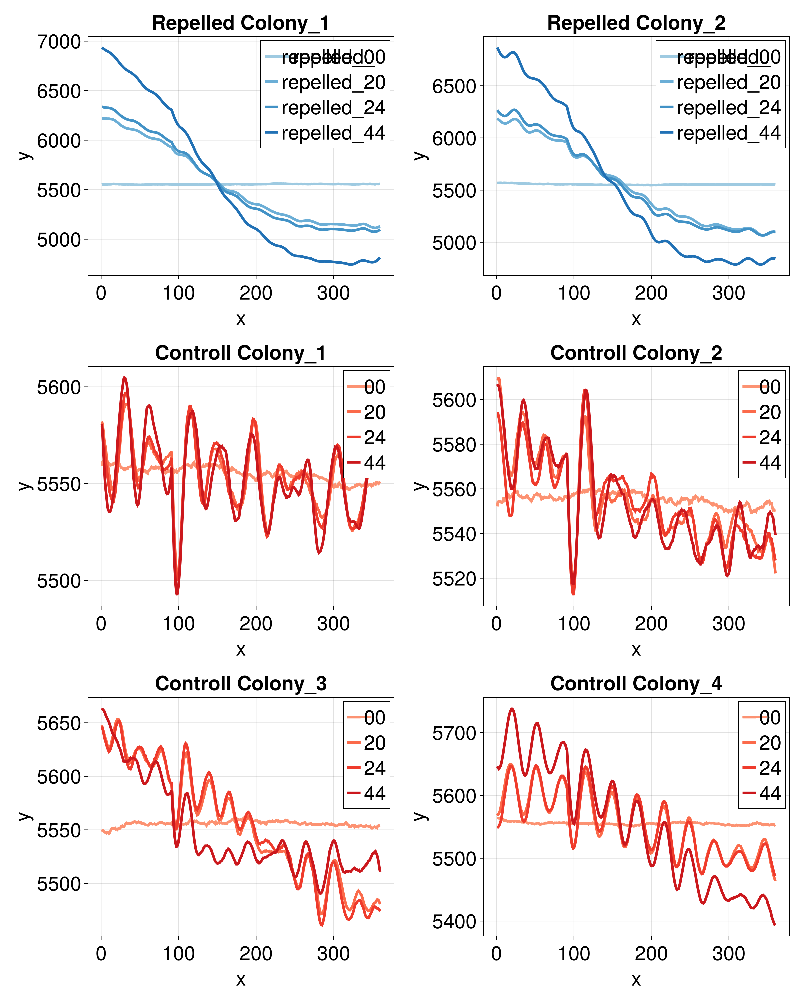

In [22]:
fig_all_pair_average = Figure(size = (1200,1500))
j =0
for (k, i) in pairs(groupby(data_evo_active,:colony))
    ax = Axis(fig_all_pair_average[1,j+1], xlabel = "x", ylabel = "y", title = "Repelled Colony_$(j+1)")
    for l in 1:length(i.pair_OG)
        lines!(ax, moving_avg(i.pair_OG[l]), label = "repelled_$(data_evo_active.time[l])", color = co.Blues[l+3])
        axislegend(ax)
    end
    j += 1
end
for (k, i) in pairs(groupby(data_evo_passive,:colony))
    ax = Axis(fig_all_pair_average[j÷2+1,(j%2)+1], xlabel = "x", ylabel = "y", title = "Controll Colony_$(j+-1)")
    for l in 1:length(i.pair_OG)
        lines!(ax, moving_avg(i.pair_OG[l]), label = "$(data_evo_active.time[l])", color = co.Reds[l+3])
        axislegend(ax)
    end
    j += 1
end

fig_all_pair_average

## Comparison with other non control colonies

In [23]:
data_sets_r = unique(data_full.data_set)

data_used = @subset(data_r, :data_set .== data_sets_r[4])
first(data_used,1)

Row,data_set,colony,time,metric_OG,metric_cov,pair_OG,pair_cov,OG_size,border_points,Parameters
,String,String,Int64,Array…,Array…,Array…,Array…,Int64,Array…,paramete…
1,26_06_23_stacked_full_res 2024_04_16,Kolonie-1 seg manuell.tif,0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0 … 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[84, 74, 75, 76, 76, 74, 77, 74, 76, 79 … 53, 58, 58, 64, 68, 76, 81, 78, 78, 84]","[5702, 5774, 5673, 5880, 5872, 5638, 5840, 5810, 5601, 5684 … 5655, 5546, 5671, 5694, 5732, 5678, 5701, 5622, 5550, 5649]","[5635, 5884, 5890, 5805, 5896, 5690, 5789, 5727, 5712, 5747 … 5634, 5531, 5663, 5644, 5566, 5745, 5608, 5564, 5475, 5602]",22171,"CartesianIndex{2}[CartesianIndex(1005, 819), CartesianIndex(1006, 819), CartesianIndex(1007, 819), CartesianIndex(1008, 819), CartesianIndex(1009, 819), CartesianIndex(1010, 819), CartesianIndex(1011, 819), CartesianIndex(1012, 819), CartesianIndex(1013, 819), CartesianIndex(1014, 819) … CartesianIndex(1012, 996), CartesianIndex(1013, 996), CartesianIndex(1014, 996), CartesianIndex(1015, 996), CartesianIndex(1016, 996), CartesianIndex(1017, 996), CartesianIndex(1018, 996), CartesianIndex(1019, 996), CartesianIndex(1020, 996), CartesianIndex(1021, 996)]","parameters([0.0, 3.0, 19.0, 24.0, 43.0, 48.0], 0.8, 0.8, 0.4, 360, 2000000, 300, [1812, 1686], 6, 91, [906, 843], 0.029717, #5, 0.01, [0 1 0; 1 -4 1; 0 1 0], 8, [""Kolonie-1 seg manuell.tif"", ""Kolonie-2 seg manuell.tif"", ""Kolonie-3 seg manuell.tif"", ""Kolonie-4 seg manuell.tif"", ""Kolonie-5 seg manuell.tif"", ""Kolonie-6 seg manuell.tif"", ""Kolonie-7 seg manuell.tif"", ""Kolonie-8 seg manuell.tif""], 2.0, [0.0, 0.0918266, 0.744375, 1.01943, 2.52265, 3.07811], [0.0918266, 0.652548, 0.275057, 1.50321, 0.555459], 15, 0.1, #7, 0.2, 0.995, 0.995)"


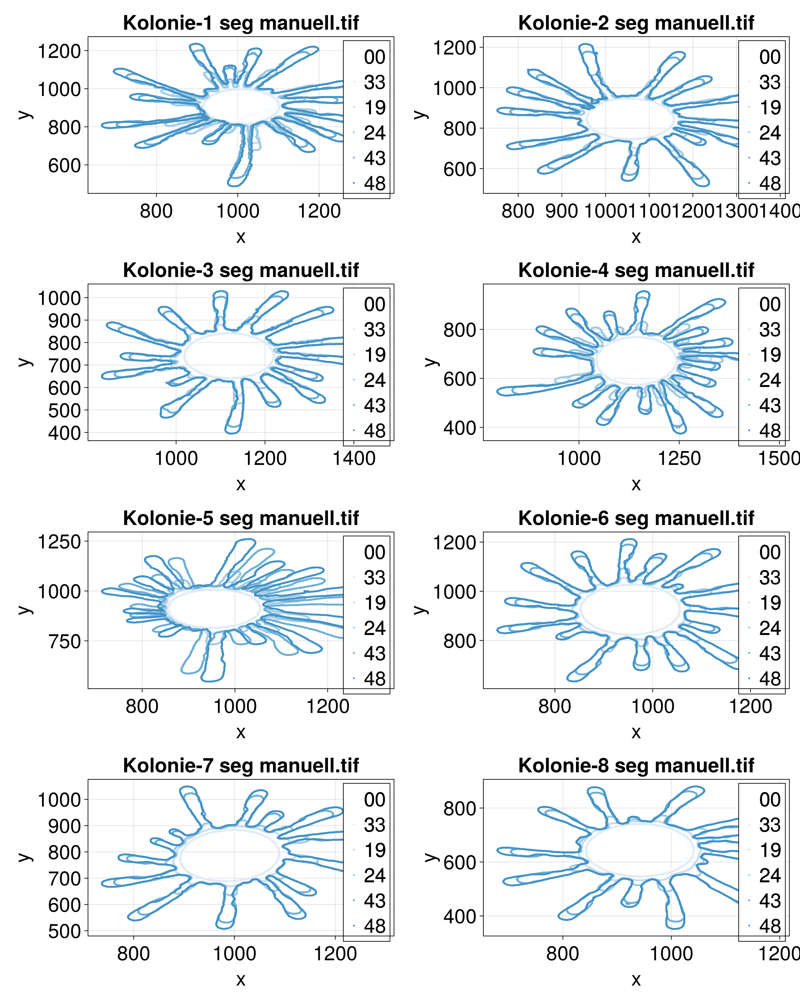

In [24]:
fig_contour_test = Figure(size = (1200,1500))
j =0

for (k, i) in pairs(groupby(data_used,:colony))
    ax = Axis(fig_contour_test[j÷2+1,(j%2)+1], xlabel = "x", ylabel = "y" , title = "$(i.colony[1])")
    for l in 1:(length(i.time)-0)
        scatter!(ax,Point2f.(Tuple.(i.border_points[l])), markersize = 4, color = co.Blues[l], label = "$(i.time[l])")
        axislegend(ax)
    end
    j += 1
end

fig_contour_test

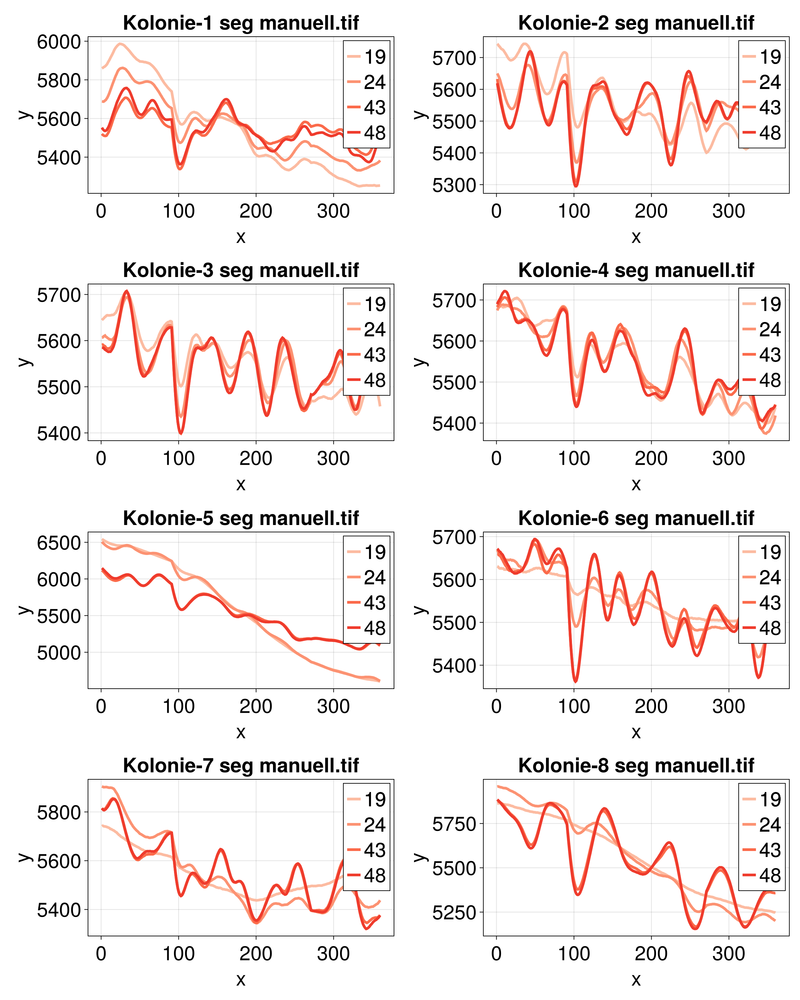

In [25]:
fig_all_pair_average_test = Figure(size = (1200,1500))
j =0


for (k, i) in pairs(groupby(data_used,:colony))
    ax = Axis(fig_all_pair_average_test[j÷2+1,(j%2)+1], xlabel = "x", ylabel = "y", title = "$(i.colony[1])")
    for l in 3:length(i.pair_OG)
        lines!(ax, moving_avg(i.pair_OG[l],180), label = "$(i.time[l])", color = co.Reds[l])
        #lines!(ax,(i.pair_OG[l]), label = "$(i.time[l])", color = co.Blues[l])
        axislegend(ax)
    end
    j += 1
end

fig_all_pair_average_test

In [26]:
aniso_max_single = @chain data_a begin
    groupby([:time,:data_set])
    @combine(:aniso_OG = mean(anisotropy_index.(:pair_OG)),
    :aniso_OG_stdd =std(anisotropy_index.(:pair_OG)) )
end

aniso_max_single_cov = @chain data_a begin
    #@subset(:time .> 0)
    groupby([:time,:data_set])
    @combine(:aniso_OG = mean(anisotropy_index.(:pair_OG)),
    :aniso_OG_stdd =std(anisotropy_index.(:pair_OG)) , :aniso_cov = mean(anisotropy_index.(:pair_cov)),:aniso_cov_stdd =std(anisotropy_index.(:pair_cov)) )
end


aniso_max_r = @chain data_full begin
    groupby(:time)
     @combine(:aniso_OG = mean(anisotropy_index.(:pair_OG)),
     :aniso_OG_stdd =std(anisotropy_index.(:pair_OG)) , :aniso_cov = mean(anisotropy_index.(:pair_cov)),:aniso_cov_stdd =std(anisotropy_index.(:pair_cov)) )
end

aniso_max_evo_active = @chain data_evo_active begin
    groupby(:time)
    @combine(:aniso_OG = mean(anisotropy_index.(:pair_OG)),
    :aniso_OG_stdd =std(anisotropy_index.(:pair_OG)) )
end

aniso_max_evo_passive = @chain data_evo_passive begin
    groupby(:time)
    @combine(:aniso_OG = mean(anisotropy_index.(:pair_OG)),
    :aniso_OG_stdd =std(anisotropy_index.(:pair_OG)) )
end


aniso_max_single_30  = @chain data_a_30 begin
    groupby([:time,:data_set])
    @combine(:aniso_OG = mean(anisotropy_index.(:pair_OG)),
    :aniso_OG_stdd =std(anisotropy_index.(:pair_OG)) )
end

aniso_max_single_8  = @chain data_a_8 begin
    groupby([:time,:data_set])
    @combine(:aniso_OG = mean(anisotropy_index.(:pair_OG)),
    :aniso_OG_stdd =std(anisotropy_index.(:pair_OG)) )
end

aniso_max_single_30_cov = @chain data_a_30 begin
    #@subset(:time .> 0)
    groupby([:time,:data_set])
    @combine(:aniso_OG = mean(anisotropy_index.(:pair_OG)),
    :aniso_OG_stdd =std(anisotropy_index.(:pair_OG)) , :aniso_cov = mean(anisotropy_index.(:pair_cov)),:aniso_cov_stdd =std(anisotropy_index.(:pair_cov)) )
end

aniso_max_single_8_cov = @chain data_a_8 begin
    @subset(:time .> 0)
    groupby([:time,:data_set])
    @combine(:aniso_OG = mean(anisotropy_index.(:pair_OG)),
    :aniso_OG_stdd =std(anisotropy_index.(:pair_OG)) , :aniso_cov = mean(anisotropy_index.(:pair_cov)),:aniso_cov_stdd =std(anisotropy_index.(:pair_cov)) )
end;

In [27]:
arti_data = [aniso_max_single_8_cov, aniso_max_single_cov, aniso_max_single_30_cov];
arti_data_og = [aniso_max_single_8, aniso_max_single, aniso_max_single_30];

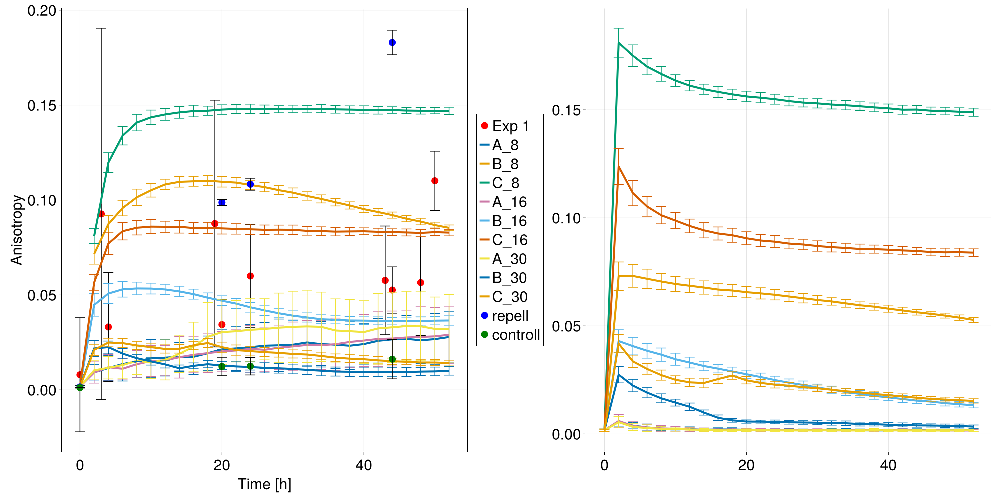

In [28]:
model_name = ["A_8","B_8","C_8", "A_16","B_16","C_16", "A_30","B_30","C_30"]
fig1 = Figure(size = (2000,1000))
ax = CairoMakie.Axis(fig1[1,1])
scatter!(ax,aniso_max_r.time,aniso_max_r.aniso_cov, markersize = 20, color = "red")
errorbars!(ax,aniso_max_r.time,aniso_max_r.aniso_cov, aniso_max_r.aniso_cov_stdd,whiskerwidth = 20, color = :black)
ax.xlabel ="Time [h]"
ax.ylabel ="Anisotropy"
j = 1


for data in arti_data
    for (k, i) in pairs(groupby(data,:data_set))
        lines!(ax, i.time, i.aniso_cov, label = model_name[j],linewidth = 4)
        errorbars!(ax, i.time, i.aniso_cov,i.aniso_cov_stdd )
        j += 1
    end
end

ax3 = CairoMakie.Axis(fig1[1,3])
j = 1
for data in arti_data_og
    for (k, i) in pairs(groupby(data,:data_set))
        lines!(ax3, i.time, i.aniso_OG, label = model_name[j],linewidth = 4)
        errorbars!(ax3, i.time, i.aniso_OG,i.aniso_OG_stdd )
        j += 1
    end
end
"""
for (k, i) in pairs(groupby(aniso_max_single_cov,:data_set))
    lines!(ax, i.time, i.aniso_cov, label = mk_label(k.data_set),linewidth = 4)
    #lines!(ax, i.time, i.aniso_OG, label = model_name[j],linewidth = 4)
    errorbars!(ax, i.time, i.aniso_cov,i.aniso_cov_stdd )
    j += 1
end


j = 1
for (k, i) in pairs(groupby(pair_max_single,:data_set))
    #lines!(ax, i.time, i.pair_og, label = mk_label(k.data_set),linewidth = 4)
    lines!(ax, i.time, i.pair_og, label = model_name[j],linewidth = 4)
    errorbars!(ax, i.time, i.pair_og,i.pair_og_stdd )
    j += 1
end

"""

## evo active
scatter!(ax,aniso_max_evo_active.time,aniso_max_evo_active.aniso_OG, markersize = 20, color = "blue", label ="repell")
errorbars!(ax,aniso_max_evo_active.time,aniso_max_evo_active.aniso_OG, aniso_max_evo_active.aniso_OG_stdd,whiskerwidth = 20, color = :black)

## evo passive

scatter!(ax,aniso_max_evo_passive.time,aniso_max_evo_passive.aniso_OG, markersize = 20, color = "green", label ="controll")
errorbars!(ax,aniso_max_evo_passive.time,aniso_max_evo_passive.aniso_OG, aniso_max_evo_passive.aniso_OG_stdd,whiskerwidth = 20, color = :black)

Legend(fig1[1,2],ax)
save(joinpath(path,"Comparision_controll_repell_aniso.pdf"),fig1)
fig1

### Check out artifical created colonies anisotropy index

In [29]:
first(arti_data[3],1)

Row,time,data_set,aniso_OG,aniso_OG_stdd,aniso_cov,aniso_cov_stdd
,Int64,String,Float64,Float64,Float64,Float64
1,0,Random 2024_04_22,0.00170178,0.000590582,0.00169201,0.000469107


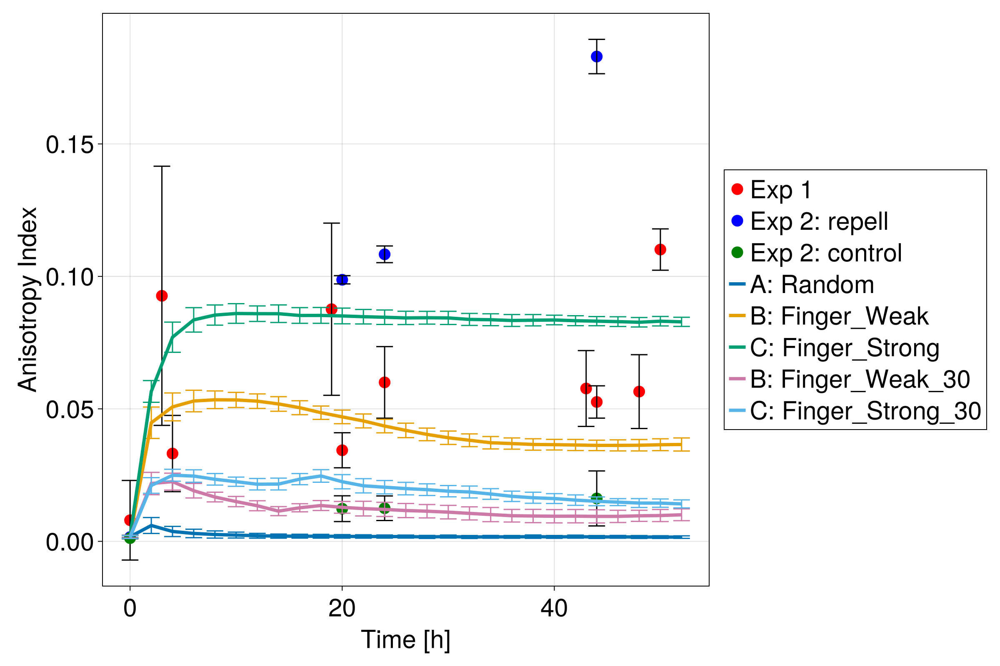

In [30]:

arti_data = [aniso_max_single_8_cov, aniso_max_single_cov, aniso_max_single_30_cov];
arti_data_og = [aniso_max_single_8, aniso_max_single, aniso_max_single_30];

model_name = ["A: Random","B: Finger_Weak","C: Finger_Strong","A: Random","B: Finger_Weak_30","C: Finger_Strong_30"] 
fig1 = Figure(size = (1200,800))
ax = CairoMakie.Axis(fig1[1,1])
scatter!(ax,aniso_max_r.time,aniso_max_r.aniso_cov, markersize = 20, color = "red")
errorbars!(ax,aniso_max_r.time,aniso_max_r.aniso_cov, aniso_max_r.aniso_cov_stdd*.5,whiskerwidth = 20, color = :black)
ax.xlabel ="Time [h]"
ax.ylabel ="Anisotropy Index"
j = 1

## evo active
scatter!(ax,aniso_max_evo_active.time,aniso_max_evo_active.aniso_OG, markersize = 20, color = "blue", label ="Exp 2: repell")
errorbars!(ax,aniso_max_evo_active.time,aniso_max_evo_active.aniso_OG, aniso_max_evo_active.aniso_OG_stdd,whiskerwidth = 20, color = :black)

## evo passive

scatter!(ax,aniso_max_evo_passive.time,aniso_max_evo_passive.aniso_OG, markersize = 20, color = "green", label ="Exp 2: control")
errorbars!(ax,aniso_max_evo_passive.time,aniso_max_evo_passive.aniso_OG, aniso_max_evo_passive.aniso_OG_stdd,whiskerwidth = 20, color = :black)


for data in arti_data[2:3]
    for (k, i) in pairs(groupby(data,:data_set))
        if j == 4
            j += 1
            continue
        end
        if i.data_set[1][1:2] == "Ra"
            lines!(ax, i.time, i.aniso_OG, label = model_name[j],linewidth = 4)
            errorbars!(ax, i.time, i.aniso_OG,i.aniso_OG_stdd )
            
        else
        #lines!(ax, i.time, i.pair_og, label = model_name[j],linewidth = 4)
        #errorbars!(ax, i.time, i.pair_og,i.pair_og_stdd )
            lines!(ax, i.time, i.aniso_cov, label = "$(model_name[j])",linewidth = 4)
            errorbars!(ax, i.time, i.aniso_cov,i.aniso_cov_stdd )
        
        end
        j += 1
    end
end

"""
for (k, i) in pairs(groupby(aniso_max_single_cov,:data_set))
    lines!(ax, i.time, i.aniso_cov, label = mk_label(k.data_set),linewidth = 4)
    #lines!(ax, i.time, i.aniso_OG, label = model_name[j],linewidth = 4)
    errorbars!(ax, i.time, i.aniso_cov,i.aniso_cov_stdd )
    j += 1
end


j = 1
for (k, i) in pairs(groupby(pair_max_single,:data_set))
    #lines!(ax, i.time, i.pair_og, label = mk_label(k.data_set),linewidth = 4)
    lines!(ax, i.time, i.pair_og, label = model_name[j],linewidth = 4)
    errorbars!(ax, i.time, i.pair_og,i.pair_og_stdd )
    j += 1
end
"""



#axislegend(ax)  
Legend(fig1[1,2],ax)
save(joinpath(path,"Comparision_controll_repell_aniso_2.pdf"),fig1)
fig1

In [31]:
data_sets_a = unique(data_a.data_set)

data_used_a = @subset(data_a, :data_set .== data_sets_a[3])
first(data_used_a,1)

Row,data_set,colony,time,metric_OG,metric_cov,pair_OG,pair_cov,OG_size,border_points,Parameters
,String,String,Int64,Array…,Array…,Array…,Array…,Int64,Array…,paramete…
1,Finger_strong 2024_04_23,Colony 1 artifical,0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0 … 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[63, 46, 59, 53, 58, 57, 57, 58, 56, 62 … 53, 62, 56, 58, 57, 57, 58, 53, 59, 63]","[5551, 5523, 5650, 5631, 5668, 5505, 5535, 5710, 5629, 5506 … 5448, 5535, 5544, 5393, 5519, 5690, 5550, 5572, 5716, 5523]","[5467, 5533, 5571, 5681, 5612, 5507, 5629, 5609, 5536, 5479 … 5355, 5636, 5572, 5585, 5589, 5551, 5616, 5647, 5536, 5605]",20589,"CartesianIndex{2}[CartesianIndex(788, 720), CartesianIndex(789, 720), CartesianIndex(790, 720), CartesianIndex(791, 720), CartesianIndex(792, 720), CartesianIndex(793, 720), CartesianIndex(794, 720), CartesianIndex(795, 720), CartesianIndex(796, 720), CartesianIndex(797, 720) … CartesianIndex(803, 880), CartesianIndex(804, 880), CartesianIndex(805, 880), CartesianIndex(806, 880), CartesianIndex(807, 880), CartesianIndex(808, 880), CartesianIndex(809, 880), CartesianIndex(810, 880), CartesianIndex(811, 880), CartesianIndex(812, 880)]","parameters([0.0, 2.0, 4.0, 6.0, 8.0, 10.0, 12.0, 14.0, 16.0, 18.0 … 34.0, 36.0, 38.0, 40.0, 42.0, 44.0, 46.0, 48.0, 50.0, 52.0], 0.8, 0.8, 0.4, 360, 2000000, 300, [1600, 1600], 27, 80, [800, 800], [0.0297605, 0.0, 0.0, 0.0], #5, 0.01, [0 1 0; 1 -4 1; 0 1 0], 128, [""Colony 1 artifical"", ""Colony 2 artifical"", ""Colony 3 artifical"", ""Colony 4 artifical"", ""Colony 5 artifical"", ""Colony 6 artifical"", ""Colony 7 artifical"", ""Colony 8 artifical"", ""Colony 9 artifical"", ""Colony 10 artifical"" … ""Colony 119 artifical"", ""Colony 120 artifical"", ""Colony 121 artifical"", ""Colony 122 artifical"", ""Colony 123 artifical"", ""Colony 124 artifical"", ""Colony 125 artifical"", ""Colony 126 artifical"", ""Colony 127 artifical"", ""Colony 128 artifical""], 2.0, [0.0, 0.0604066, 0.124462, 0.192387, 0.264415, 0.340794, 0.421787, 0.507672, 0.598745, 0.69532 … 1.71039, 1.87411, 2.04773, 2.23183, 2.42705, 2.63407, 2.85359, 3.08637, 3.33322, 3.59497], [0.0604066, 0.0640555, 0.0679249, 0.072028, 0.076379, 0.0809928, 0.0858853, 0.0910733, 0.0965748, 0.102409 … 0.154398, 0.163725, 0.173615, 0.184103, 0.195224, 0.207017, 0.219522, 0.232782, 0.246844, 0.261755], 15, 0.1, #7, 0.2, 0.999, 0.999)"


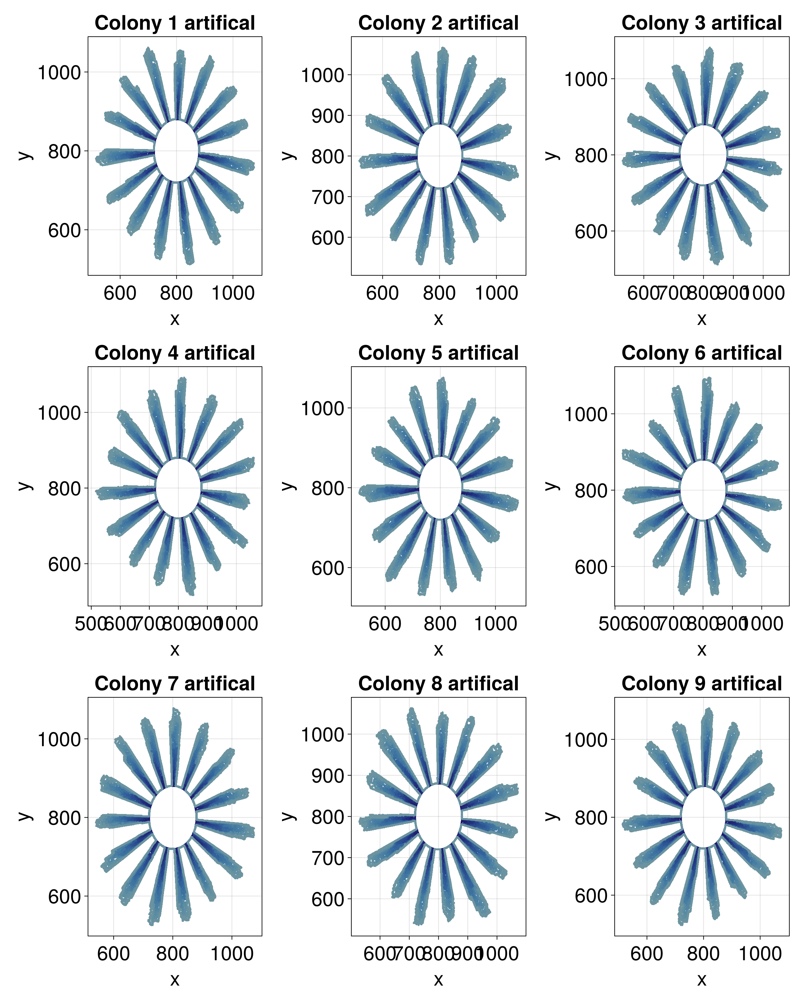

In [33]:
fig_contour_test_A = Figure(size = (1200,1500))
j =0

for (k, i) in pairs(groupby(data_used_a,:colony)[1:9])
    ax = Axis(fig_contour_test_A[j÷3+1,(j%3)+1], xlabel = "x", ylabel = "y" , title = "$(i.colony[1])")
    for l in 1:length(i.time)
        scatter!(ax,Point2f.(Tuple.(i.border_points[l])), markersize = 4, color = co.lapaz50[l], label = "$(i.time[l])")
        #axislegend(ax)
    end
    j += 1
end

fig_contour_test_A

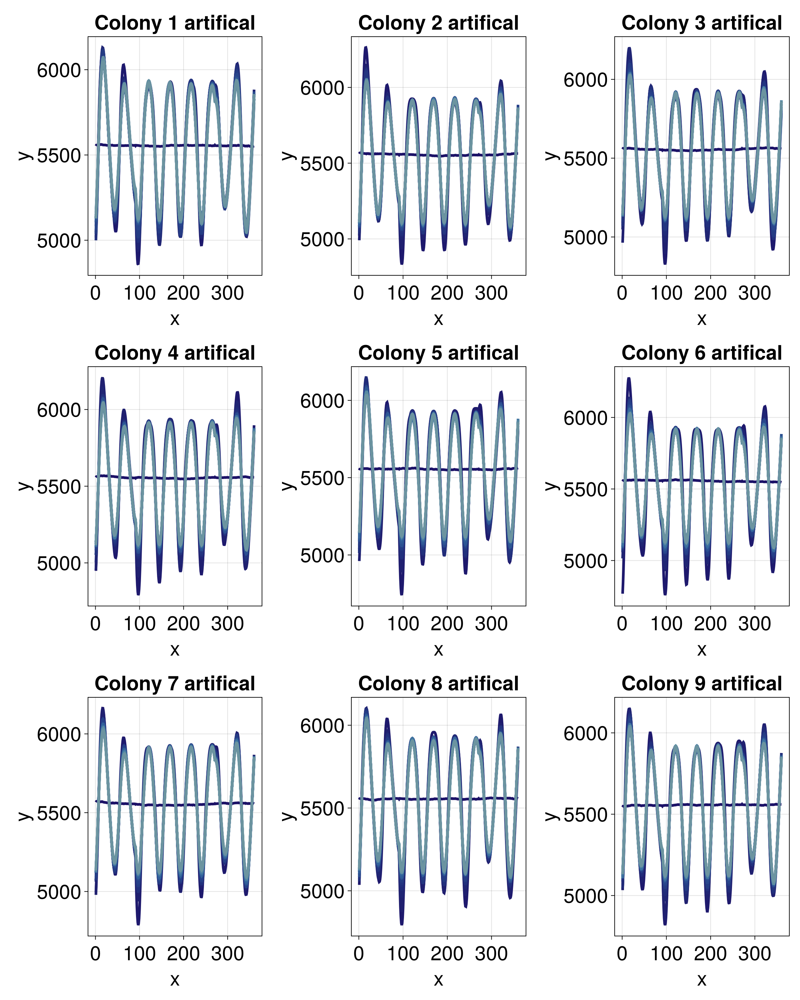

In [34]:
fig_all_pair_average_test = Figure(size = (1200,1500))
j =0




for (k, i) in pairs(groupby(data_used_a,:colony)[1:9])
    ax = Axis(fig_all_pair_average_test[j÷3+1,(j%3)+1], xlabel = "x", ylabel = "y", title = "$(i.colony[1])")
    for l in 1:length(i.pair_OG)
        lines!(ax, moving_avg(i.pair_OG[l],180), label = "$(i.time[l])", color = co.lapaz50[l])
        #lines!(ax,(i.pair_OG[l]), label = "$(i.time[l])", color = co.lajolla50[l])
        #axislegend(ax)
    end
    j += 1
end

fig_all_pair_average_test

## surface

In [37]:
first(data_a)

Row,data_set,colony,time,metric_OG,metric_cov,pair_OG,pair_cov,OG_size,border_points,Parameters
,String,String,Int64,Array…,Array…,Array…,Array…,Int64,Array…,paramete…
1,Random 2024_04_23,Colony 1 artifical,0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0 … 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[63, 46, 59, 53, 58, 57, 57, 58, 56, 62 … 53, 62, 56, 58, 57, 57, 58, 53, 59, 63]","[5517, 5547, 5632, 5629, 5585, 5418, 5525, 5469, 5494, 5417 … 5578, 5489, 5521, 5323, 5490, 5575, 5712, 5578, 5523, 5565]","[5359, 5643, 5573, 5572, 5704, 5706, 5579, 5602, 5593, 5431 … 5666, 5453, 5689, 5521, 5384, 5440, 5529, 5642, 5668, 5451]",20589,"CartesianIndex{2}[CartesianIndex(788, 720), CartesianIndex(789, 720), CartesianIndex(790, 720), CartesianIndex(791, 720), CartesianIndex(792, 720), CartesianIndex(793, 720), CartesianIndex(794, 720), CartesianIndex(795, 720), CartesianIndex(796, 720), CartesianIndex(797, 720) … CartesianIndex(803, 880), CartesianIndex(804, 880), CartesianIndex(805, 880), CartesianIndex(806, 880), CartesianIndex(807, 880), CartesianIndex(808, 880), CartesianIndex(809, 880), CartesianIndex(810, 880), CartesianIndex(811, 880), CartesianIndex(812, 880)]","parameters([0.0, 2.0, 4.0, 6.0, 8.0, 10.0, 12.0, 14.0, 16.0, 18.0 … 34.0, 36.0, 38.0, 40.0, 42.0, 44.0, 46.0, 48.0, 50.0, 52.0], 0.8, 0.8, 0.4, 360, 2000000, 300, [1600, 1600], 27, 80, [800, 800], [0.0297605, 0.0, 0.0, 0.0], #5, 0.01, [0 1 0; 1 -4 1; 0 1 0], 128, [""Colony 1 artifical"", ""Colony 2 artifical"", ""Colony 3 artifical"", ""Colony 4 artifical"", ""Colony 5 artifical"", ""Colony 6 artifical"", ""Colony 7 artifical"", ""Colony 8 artifical"", ""Colony 9 artifical"", ""Colony 10 artifical"" … ""Colony 119 artifical"", ""Colony 120 artifical"", ""Colony 121 artifical"", ""Colony 122 artifical"", ""Colony 123 artifical"", ""Colony 124 artifical"", ""Colony 125 artifical"", ""Colony 126 artifical"", ""Colony 127 artifical"", ""Colony 128 artifical""], 2.0, [0.0, 0.0604066, 0.124462, 0.192387, 0.264415, 0.340794, 0.421787, 0.507672, 0.598745, 0.69532 … 1.71039, 1.87411, 2.04773, 2.23183, 2.42705, 2.63407, 2.85359, 3.08637, 3.33322, 3.59497], [0.0604066, 0.0640555, 0.0679249, 0.072028, 0.076379, 0.0809928, 0.0858853, 0.0910733, 0.0965748, 0.102409 … 0.154398, 0.163725, 0.173615, 0.184103, 0.195224, 0.207017, 0.219522, 0.232782, 0.246844, 0.261755], 15, 0.1, #7, 0.2, 0.999, 0.999)"


In [38]:
surface_arti = @chain data_a begin 
    groupby([:time, :data_set])
    @combine(:surface = mean(length.(:border_points)))
end

surface_arti_30  = @chain data_a_30 begin 
    groupby([:time, :data_set])
    @combine(:surface = mean(length.(:border_points)))
end

surface_real = @chain data_full begin 
    groupby(:time)
    @combine(:surface = mean(length.(:border_points)))
end


surface_active = @chain data_evo_active begin 
    groupby(:time)
    @combine(:surface = mean(length.(:border_points)))
end

surface_passive = @chain data_evo_passive begin 
    groupby(:time)
    @combine(:surface = mean(length.(:border_points)))
end
surface_passive

Row,time,surface
,Int64,Float64
1,0,846.75
2,20,9899.5
3,24,11667.5
4,44,17452.0


In [39]:
surface_real = @chain data_full begin 
    groupby(:time)
    @combine(:surface = mean(length.(:border_points)))
end
surface_real

Row,time,surface
,Int64,Float64
1,0,535.966
2,3,565.25
3,4,431.167
4,19,1289.88
5,20,1199.5
6,24,1668.93
7,43,4477.62
8,44,4036.17
9,48,4735.76


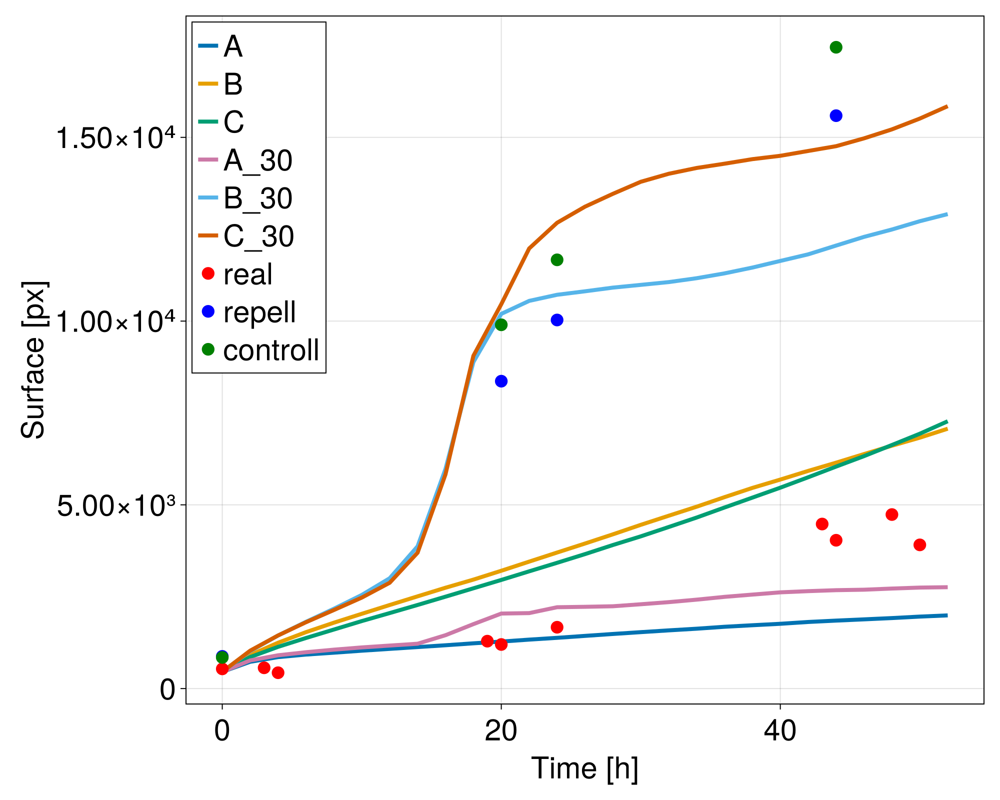

In [40]:
model_name = ["A","B","C", "A_30", "B_30", "C_30"]
j = 1
fig = Figure()
ax = Axis(fig[1,1], xlabel = "Time [h]", ylabel = "Surface [px]")
for (k, i) in pairs(groupby(surface_arti,:data_set))
    lines!(ax, i.time, i.surface, label = "$(model_name[j])",linewidth = 4)
    #scatter!(ax, i.time, i.surface, label = model_name[j],linewidth = 4)
    j += 1
end



for (k,i) in pairs(groupby(surface_arti_30,:data_set))
    lines!(ax, i.time, i.surface, label = "$(model_name[j])",linewidth = 4)
    #scatter!(ax, i.time, i.surface, label = model_name[j],linewidth = 4)
    j += 1
end

scatter!(ax, surface_real.time, surface_real.surface, label = "real", color = "red")


scatter!(ax, surface_active.time, surface_active.surface, label = "repell", color = "blue")

scatter!(ax, surface_passive.time, surface_passive.surface, label = "controll", color = "green")

axislegend(ax, position = :lt)
fig

## Pair corealtion metric

In [41]:
pair_max_single = @chain data_a begin
    groupby([:time,:data_set])
    @combine(:pair_og = mean((maximum.(:pair_OG).-mean.(:pair_OG))./mean.(:pair_OG)),
    :pair_og_stdd =std((maximum.(:pair_OG).-mean.(:pair_OG))./mean.(:pair_OG)), 
    :pair_cov = mean((maximum.(:pair_cov).-mean.(:pair_cov))./mean.(:pair_cov)), :pair_cov_stdd =std((maximum.(:pair_cov).-mean.(:pair_cov))./mean.(:pair_cov)))
end

pair_max_single_cov = @chain data_a begin
    @subset(:time .> 0)
    groupby([:time,:data_set])
    @combine(:pair_cov = mean((maximum.(:pair_cov).-mean.(:pair_cov))./mean.(:pair_cov)),
    :pair_cov_stdd =std((maximum.(:pair_cov).-mean.(:pair_cov))./mean.(:pair_cov)) )
end

pair_max_single_30 = @chain data_a_30 begin
    groupby([:time,:data_set])
    @combine(:pair_og = mean((maximum.(:pair_OG).-mean.(:pair_OG))./mean.(:pair_OG)),
    :pair_og_stdd =std((maximum.(:pair_OG).-mean.(:pair_OG))./mean.(:pair_OG)),
     :pair_cov = mean((maximum.(:pair_cov).-mean.(:pair_cov))./mean.(:pair_cov)), :pair_cov_stdd =std((maximum.(:pair_cov).-mean.(:pair_cov))./mean.(:pair_cov)) )

end

pair_max_single_cov_30 = @chain data_a_30 begin
    @subset(:time .> 0)
    groupby([:time,:data_set])
    @combine(:pair_cov = mean((maximum.(:pair_cov).-mean.(:pair_cov))./mean.(:pair_cov)),
    :pair_cov_stdd =std((maximum.(:pair_cov).-mean.(:pair_cov))./mean.(:pair_cov)) )
end

first(pair_max_single, 3)

pair_max_r = @chain data_full begin
    groupby(:time)
     @combine(:pair_og = mean((maximum.(:pair_OG).-mean.(:pair_OG))./mean.(:pair_OG)),
        :pair_og_stdd =std((maximum.(:pair_OG).-mean.(:pair_OG))./mean.(:pair_OG)) )
end

pair_max_evo_active = @chain data_evo_active begin
    groupby(:time)
     @combine(:pair_og = mean((maximum.(:pair_OG).-mean.(:pair_OG))./mean.(:pair_OG)),
        :pair_og_stdd =std((maximum.(:pair_OG).-mean.(:pair_OG))./mean.(:pair_OG)) )
end

pair_max_evo_passive = @chain data_evo_passive begin
    groupby(:time)
     @combine(:pair_og = mean((maximum.(:pair_OG).-mean.(:pair_OG))./mean.(:pair_OG)),
        :pair_og_stdd =std((maximum.(:pair_OG).-mean.(:pair_OG))./mean.(:pair_OG)) )
end

Row,time,pair_og,pair_og_stdd
,Int64,Float64,Float64
1,0,0.04049,0.00123402
2,20,0.431135,0.0458505
3,24,0.480455,0.0540133
4,44,0.54134,0.122543


In [42]:
unique(pair_max_single.data_set)

3-element Vector{String}:
 "Random 2024_04_23"
 "Finger_weak 2024_04_23"
 "Finger_strong 2024_04_23"

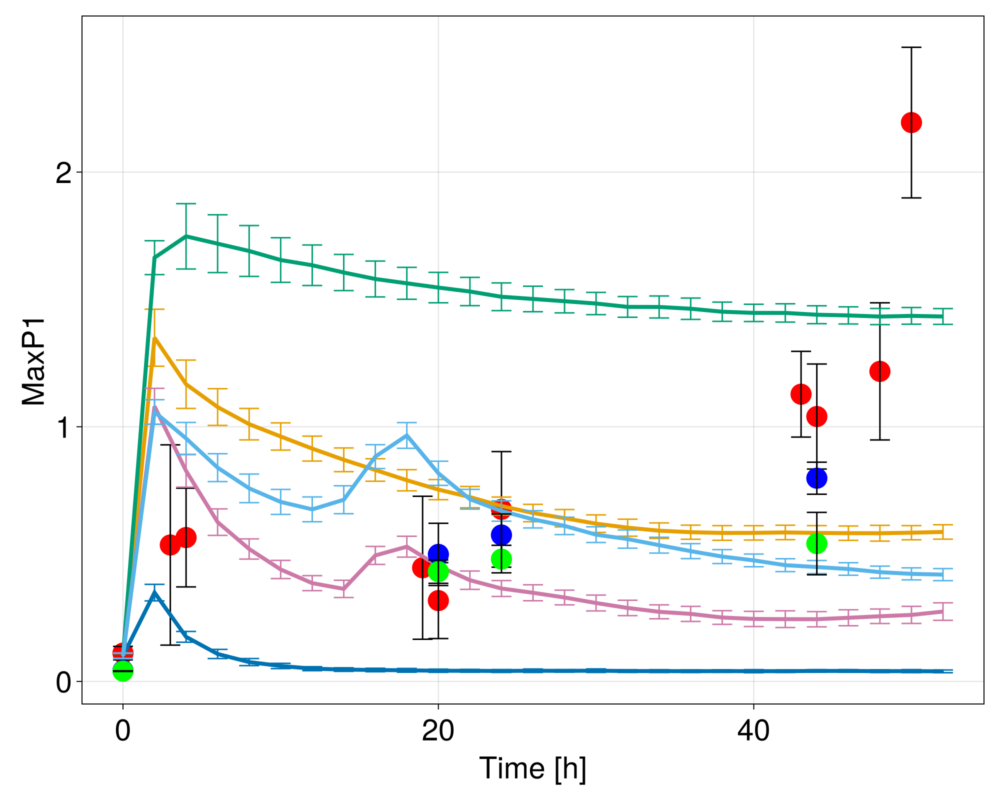

In [131]:
model_name = ["A: Random","B: Finger_weak","C: Finger_Strong","B: Finger_weak_30","C: Finger_Strong_30"] 
fig1 = Figure()
ax = CairoMakie.Axis(fig1[1,1])

markersize = 30

green = "green1"

scatter!(ax,pair_max_r.time,pair_max_r.pair_og, markersize = markersize, color = "red")
errorbars!(ax,pair_max_r.time,pair_max_r.pair_og, pair_max_r.pair_og_stdd,whiskerwidth = 20, color = :black)
ax.xlabel ="Time [h]"
ax.ylabel ="MaxP1"
j = 1
for (k, i) in pairs(groupby(pair_max_single,:data_set))
    if i.data_set[1][1:2] == "Ra"
        lines!(ax, i.time, i.pair_og, label = model_name[j],linewidth = 4)
        errorbars!(ax, i.time, i.pair_og,i.pair_og_stdd )
        
    else
    #lines!(ax, i.time, i.pair_og, label = model_name[j],linewidth = 4)
    #errorbars!(ax, i.time, i.pair_og,i.pair_og_stdd )
        lines!(ax, i.time, i.pair_cov, label = "$(model_name[j])",linewidth = 4)
        errorbars!(ax, i.time, i.pair_cov,i.pair_cov_stdd )
    
    end
    j += 1
end

for (k, i) in pairs(groupby(pair_max_single_30,:data_set))
    if i.data_set[1][1:2] == "Ra"
        continue
        lines!(ax, i.time, i.pair_og, label = model_name[j],linewidth = 4)
        errorbars!(ax, i.time, i.pair_og,i.pair_og_stdd )
    else
    #lines!(ax, i.time, i.pair_og, label = model_name[j],linewidth = 4)
    #errorbars!(ax, i.time, i.pair_og,i.pair_og_stdd )
        lines!(ax, i.time, i.pair_cov, label = "$(model_name[j])",linewidth = 4)
        errorbars!(ax, i.time, i.pair_cov,i.pair_cov_stdd )
    end
    j += 1
end

#pair_max_single_cov_30

"""
j = 1
for (k, i) in pairs(groupby(pair_max_single,:data_set))
    #lines!(ax, i.time, i.pair_og, label = mk_label(k.data_set),linewidth = 4)
    lines!(ax, i.time, i.pair_og, label = model_name[j],linewidth = 4)
    errorbars!(ax, i.time, i.pair_og,i.pair_og_stdd )
    j += 1
end

"""

## evo active
scatter!(ax,pair_max_evo_active.time,pair_max_evo_active.pair_og, markersize = markersize, color = "blue", label ="repell")
errorbars!(ax,pair_max_evo_active.time,pair_max_evo_active.pair_og, pair_max_evo_active.pair_og_stdd,whiskerwidth = 20, color = :black)

## evo passive

scatter!(ax,pair_max_evo_passive.time,pair_max_evo_passive.pair_og, markersize = markersize, color = green, label ="controll")
errorbars!(ax,pair_max_evo_passive.time,pair_max_evo_passive.pair_og, pair_max_evo_passive.pair_og_stdd,whiskerwidth = 20, color = :black)


#axislegend(ax, position = :ct)
save(joinpath(path,"Comparision_controll_repell_maxP1.pdf"),fig1)
fig1

## Coefficent of variantion 

In [44]:
cv_angular_max = @chain data_a begin
    groupby(:time)
    @combine(:cv_angu = mean(std.(:metric_OG)./(mean.(:metric_OG))), :cv_angu_std = std(std.(:metric_OG)./(mean.(:metric_OG))))
end
first(cv_angular_max,3)

cv_angular_max_single = @chain data_a begin 
    groupby([:time,:data_set])
    @combine(:cv_angu = mean(std.(:metric_OG)./(mean.(:metric_OG))), :cv_angu_std = std(std.(:metric_OG)./(mean.(:metric_OG))))
end


cv_angular_max_single_30 = @chain data_a_30 begin 
    groupby([:time,:data_set])
    @combine(:cv_angu = mean(std.(:metric_OG)./(mean.(:metric_OG))), :cv_angu_std = std(std.(:metric_OG)./(mean.(:metric_OG))))
end


first(cv_angular_max_single,3)

Row,time,data_set,cv_angu,cv_angu_std
,Int64,String,Float64,Float64
1,0,Random 2024_04_23,NaN,NaN
2,2,Random 2024_04_23,0.539007,0.0241181
3,4,Random 2024_04_23,0.359444,0.0188739


In [45]:
cv_angular_max_r = @chain data_full begin
    groupby(:time)
    @combine(:cv_OG = mean(std.(:metric_OG)./(mean.(:metric_OG))),:cv_OG_std = std(std.(:metric_OG)./(mean.(:metric_OG))))
end

cv_angular_max_evo_active = @chain data_evo_active begin
    groupby(:time)
    @combine(:cv_OG = mean(std.(:metric_OG)./(mean.(:metric_OG))),:cv_OG_std = std(std.(:metric_OG)./(mean.(:metric_OG))))
end

cv_angular_max_evo_passive = @chain data_evo_passive begin
    groupby(:time)
    @combine(:cv_OG = mean(std.(:metric_OG)./(mean.(:metric_OG))),:cv_OG_std = std(std.(:metric_OG)./(mean.(:metric_OG))))
end

Row,time,cv_OG,cv_OG_std
,Int64,Float64,Float64
1,0,NaN,NaN
2,20,0.651069,0.0344862
3,24,0.686057,0.0387643
4,44,0.72285,0.0722665


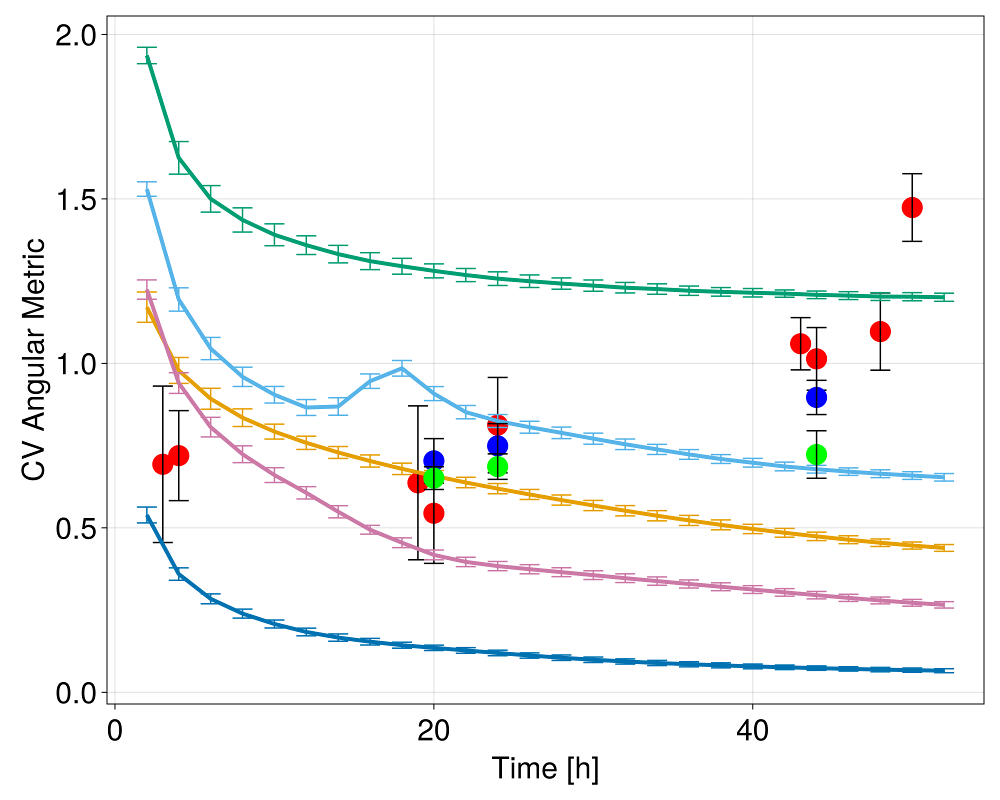

In [132]:
fig3 = Figure()
ax = CairoMakie.Axis(fig3[1,1])
scatter!(ax,cv_angular_max_r.time,cv_angular_max_r.cv_OG, color = :red, markersize = markersize)
errorbars!(ax,cv_angular_max_r.time,cv_angular_max_r.cv_OG, cv_angular_max_r.cv_OG_std, color = :black)
ax.xlabel ="Time [h]"
ax.ylabel ="CV Angular Metric"
j = 1
for (k, i) in pairs(groupby(cv_angular_max_single,:data_set))
    #lines!(ax, i.time, i.cv_angu, label  = mk_label(k.data_set))
    lines!(ax,  i.time, i.cv_angu, label = model_name[j],linewidth = 4)
    errorbars!(ax, i.time, i.cv_angu,i.cv_angu_std )
    j += 1
end

for (k, i) in pairs(groupby(cv_angular_max_single_30,:data_set))
    if i.data_set[1][1:2] == "Ra"
        continue
        lines!(ax, i.time, i.pair_og, label = model_name[j],linewidth = 4)
        errorbars!(ax, i.time, i.pair_og,i.pair_og_stdd )
    else
    #lines!(ax, i.time, i.cv_angu, label  = mk_label(k.data_set))
        lines!(ax,  i.time, i.cv_angu, label = model_name[j],linewidth = 4)
        errorbars!(ax, i.time, i.cv_angu,i.cv_angu_std )
    end
    j += 1
end

#cv_angular_max_single_30

## evo active
scatter!(ax,cv_angular_max_evo_active.time,cv_angular_max_evo_active.cv_OG, markersize = markersize , color = "blue", label ="repell")
errorbars!(ax,cv_angular_max_evo_active.time,cv_angular_max_evo_active.cv_OG, cv_angular_max_evo_active.cv_OG_std, color = :black)

## evo passive
scatter!(ax,cv_angular_max_evo_passive.time,cv_angular_max_evo_passive.cv_OG, markersize = markersize , color = green, label ="controll")
errorbars!(ax,cv_angular_max_evo_passive.time,cv_angular_max_evo_passive.cv_OG, cv_angular_max_evo_passive.cv_OG_std, color = :black)


#axislegend(ax, position = :ct)

save(joinpath(path,"Comparision_CV_controll_repell.pdf"),fig3)
fig3

## Root mean square fluctations/roughness

In [110]:
first(data_r,2)

Row,data_set,colony,time,metric_OG,metric_cov,pair_OG,pair_cov,OG_size,border_points,Parameters
,String,String,Int64,Array…,Array…,Array…,Array…,Int64,Array…,paramete…
1,10_04_23_stacked_half_res 2024_04_16,Kolonie 1.tif,0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0 … 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[16, 0, 9, 6, 10, 7, 10, 8, 9, 10 … 7, 10, 9, 8, 10, 7, 10, 6, 9, 16]","[5702, 4707, 5277, 5701, 5619, 5476, 5485, 5498, 5869, 5366 … 5458, 5857, 5628, 5512, 5554, 5558, 5920, 5346, 4664, 6433]","[5727, 4594, 5200, 5573, 5727, 5404, 5659, 5419, 5819, 5432 … 5301, 5699, 5597, 5677, 5464, 5710, 5799, 5233, 4801, 6400]",2992,"CartesianIndex{2}[CartesianIndex(135, 131), CartesianIndex(136, 131), CartesianIndex(137, 131), CartesianIndex(138, 131), CartesianIndex(139, 131), CartesianIndex(140, 131), CartesianIndex(141, 131), CartesianIndex(142, 131), CartesianIndex(143, 131), CartesianIndex(131, 132) … CartesianIndex(146, 191), CartesianIndex(147, 191), CartesianIndex(135, 192), CartesianIndex(136, 192), CartesianIndex(137, 192), CartesianIndex(138, 192), CartesianIndex(139, 192), CartesianIndex(140, 192), CartesianIndex(141, 192), CartesianIndex(142, 192)]","parameters([0.0, 24.0, 48.0], 0.8, 0.8, 0.4, 360, 2000000, 300, [318, 324], 3, 16, [159, 162], 0.029717, #5, 0.01, [0 1 0; 1 -4 1; 0 1 0], 8, [""Kolonie 1.tif"", ""Kolonie 2.tif"", ""Kolonie 3.tif"", ""Kolonie 4.tif"", ""Kolonie 5.tif"", ""Kolonie 6.tif"", ""Kolonie 7.tif"", ""Kolonie 8.tif""], 2.0, [0.0, 1.01943, 3.07811], [1.01943, 2.05867], 15, 0.1, #7, 0.2, 0.995, 0.995)"
2,10_04_23_stacked_half_res 2024_04_16,Kolonie 1.tif,24,"[2, 0, 5, 4, 1, 5, 1, 4, 3, 4 … 3, 5, 4, 4, 1, 5, 1, 4, 5, 2]","[0, 0, 1, 1, 0, 1, 1, 0, 1, 1 … 0, 0, 0, 0, 1, 1, 0, 1, 1, 0]","[9153, 9560, 9396, 9473, 9387, 8797, 8838, 8535, 8115, 7999 … 5792, 5498, 5708, 5682, 5466, 5533, 5528, 5344, 5313, 5457]","[13901, 14320, 14273, 13927, 13572, 13012, 12592, 11957, 11315, 10584 … 5887, 5730, 5555, 5495, 5278, 5038, 5242, 5145, 4982, 4890]",2992,"CartesianIndex{2}[CartesianIndex(167, 104), CartesianIndex(168, 104), CartesianIndex(169, 104), CartesianIndex(170, 104), CartesianIndex(171, 104), CartesianIndex(115, 105), CartesianIndex(116, 105), CartesianIndex(117, 105), CartesianIndex(165, 105), CartesianIndex(166, 105) … CartesianIndex(122, 225), CartesianIndex(131, 225), CartesianIndex(123, 226), CartesianIndex(124, 226), CartesianIndex(129, 226), CartesianIndex(130, 226), CartesianIndex(125, 227), CartesianIndex(126, 227), CartesianIndex(127, 227), CartesianIndex(128, 227)]","parameters([0.0, 24.0, 48.0], 0.8, 0.8, 0.4, 360, 2000000, 300, [318, 324], 3, 16, [159, 162], 0.029717, #5, 0.01, [0 1 0; 1 -4 1; 0 1 0], 8, [""Kolonie 1.tif"", ""Kolonie 2.tif"", ""Kolonie 3.tif"", ""Kolonie 4.tif"", ""Kolonie 5.tif"", ""Kolonie 6.tif"", ""Kolonie 7.tif"", ""Kolonie 8.tif""], 2.0, [0.0, 1.01943, 3.07811], [1.01943, 2.05867], 15, 0.1, #7, 0.2, 0.995, 0.995)"


In [111]:
roughness_angular_max_single = @chain data_a begin 
    groupby([:time,:data_set])
    @combine(:roughness_angu = mean(std.(:metric_OG./:OG_size)),:roughness_angu_std = std(std.(:metric_OG./:OG_size)))
end

roughness_angular_max_single_30 = @chain data_a_30 begin 
    groupby([:time,:data_set])
    @combine(:roughness_angu = mean(std.(:metric_OG./:OG_size)),:roughness_angu_std = std(std.(:metric_OG./:OG_size)))
end
first(roughness_angular_max_single)

Row,time,data_set,roughness_angu,roughness_angu_std
,Int64,String,Float64,Float64
1,0,Random 2024_04_23,0.0,0.0


In [112]:
roughness_angular_max_r = @chain data_full begin
    groupby(:time)
    @combine(:roughness_OG = mean(std.(:metric_OG./:OG_size)),:roughness_OG_std = std(std.(:metric_OG)./:OG_size))
end

Row,time,roughness_OG,roughness_OG_std
,Int64,Float64,Float64
1,0,0.0,0.0
2,3,0.000175425,0.000224953
3,4,0.000195228,7.53799e-5
4,19,0.00125742,0.000917477
5,20,0.00150254,0.00048484
6,24,0.00240034,0.000916153
7,43,0.00639308,0.00171485
8,44,0.00991012,0.00141022
9,48,0.00900739,0.00254163


In [113]:
roughness_angular_right_single = @chain data_a begin 
    groupby([:time,:data_set])
    @combine(:roughness_angu = (mean(var.(:metric_OG./:OG_size, corrected = false)))^(1/2),:roughness_angu_std = (std(var.(:metric_OG./:OG_size, corrected = false)))^(1/2))
end
roughness_angular_right_single_30 = @chain data_a_30 begin 
    groupby([:time,:data_set])
    @combine(:roughness_angu = (mean(var.(:metric_OG./:OG_size, corrected = false)))^(1/2),:roughness_angu_std = (std(var.(:metric_OG./:OG_size, corrected = false)))^(1/2))
end

first(roughness_angular_right_single)

Row,time,data_set,roughness_angu,roughness_angu_std
,Int64,String,Float64,Float64
1,0,Random 2024_04_23,0.0,0.0


In [114]:
roughness_angular_right = @chain data_full begin
    groupby([:time])
    @combine(:roughness_OG = (mean(var.(:metric_OG./:OG_size, corrected = false)))^(1/2),:roughness_OG_std = (std(var.(:metric_OG./:OG_size, corrected = false)))^(1/2))
end

roughness_angular_evo_active = @chain data_evo_active begin
    groupby(:time)
    @combine(:roughness_OG = mean(std.(:metric_OG./:OG_size)),:roughness_OG_std = std(std.(:metric_OG)./:OG_size))
end

roughness_angular_evo_passive = @chain data_evo_passive begin
    groupby(:time)
    @combine(:roughness_OG = mean(std.(:metric_OG./:OG_size)),:roughness_OG_std = std(std.(:metric_OG)./:OG_size))
end

Row,time,roughness_OG,roughness_OG_std
,Int64,Float64,Float64
1,0,0.0,0.0
2,20,0.00635519,0.000186195
3,24,0.00789777,0.000204071
4,44,0.0124831,0.000360683


In [115]:
length(data_a.time)*2/3

6912.0

In [116]:
first(data_a)

Row,data_set,colony,time,metric_OG,metric_cov,pair_OG,pair_cov,OG_size,border_points,Parameters
,String,String,Int64,Array…,Array…,Array…,Array…,Int64,Array…,paramete…
1,Random 2024_04_23,Colony 1 artifical,0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0 … 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[63, 46, 59, 53, 58, 57, 57, 58, 56, 62 … 53, 62, 56, 58, 57, 57, 58, 53, 59, 63]","[5517, 5547, 5632, 5629, 5585, 5418, 5525, 5469, 5494, 5417 … 5578, 5489, 5521, 5323, 5490, 5575, 5712, 5578, 5523, 5565]","[5359, 5643, 5573, 5572, 5704, 5706, 5579, 5602, 5593, 5431 … 5666, 5453, 5689, 5521, 5384, 5440, 5529, 5642, 5668, 5451]",20589,"CartesianIndex{2}[CartesianIndex(788, 720), CartesianIndex(789, 720), CartesianIndex(790, 720), CartesianIndex(791, 720), CartesianIndex(792, 720), CartesianIndex(793, 720), CartesianIndex(794, 720), CartesianIndex(795, 720), CartesianIndex(796, 720), CartesianIndex(797, 720) … CartesianIndex(803, 880), CartesianIndex(804, 880), CartesianIndex(805, 880), CartesianIndex(806, 880), CartesianIndex(807, 880), CartesianIndex(808, 880), CartesianIndex(809, 880), CartesianIndex(810, 880), CartesianIndex(811, 880), CartesianIndex(812, 880)]","parameters([0.0, 2.0, 4.0, 6.0, 8.0, 10.0, 12.0, 14.0, 16.0, 18.0 … 34.0, 36.0, 38.0, 40.0, 42.0, 44.0, 46.0, 48.0, 50.0, 52.0], 0.8, 0.8, 0.4, 360, 2000000, 300, [1600, 1600], 27, 80, [800, 800], [0.0297605, 0.0, 0.0, 0.0], #5, 0.01, [0 1 0; 1 -4 1; 0 1 0], 128, [""Colony 1 artifical"", ""Colony 2 artifical"", ""Colony 3 artifical"", ""Colony 4 artifical"", ""Colony 5 artifical"", ""Colony 6 artifical"", ""Colony 7 artifical"", ""Colony 8 artifical"", ""Colony 9 artifical"", ""Colony 10 artifical"" … ""Colony 119 artifical"", ""Colony 120 artifical"", ""Colony 121 artifical"", ""Colony 122 artifical"", ""Colony 123 artifical"", ""Colony 124 artifical"", ""Colony 125 artifical"", ""Colony 126 artifical"", ""Colony 127 artifical"", ""Colony 128 artifical""], 2.0, [0.0, 0.0604066, 0.124462, 0.192387, 0.264415, 0.340794, 0.421787, 0.507672, 0.598745, 0.69532 … 1.71039, 1.87411, 2.04773, 2.23183, 2.42705, 2.63407, 2.85359, 3.08637, 3.33322, 3.59497], [0.0604066, 0.0640555, 0.0679249, 0.072028, 0.076379, 0.0809928, 0.0858853, 0.0910733, 0.0965748, 0.102409 … 0.154398, 0.163725, 0.173615, 0.184103, 0.195224, 0.207017, 0.219522, 0.232782, 0.246844, 0.261755], 15, 0.1, #7, 0.2, 0.999, 0.999)"


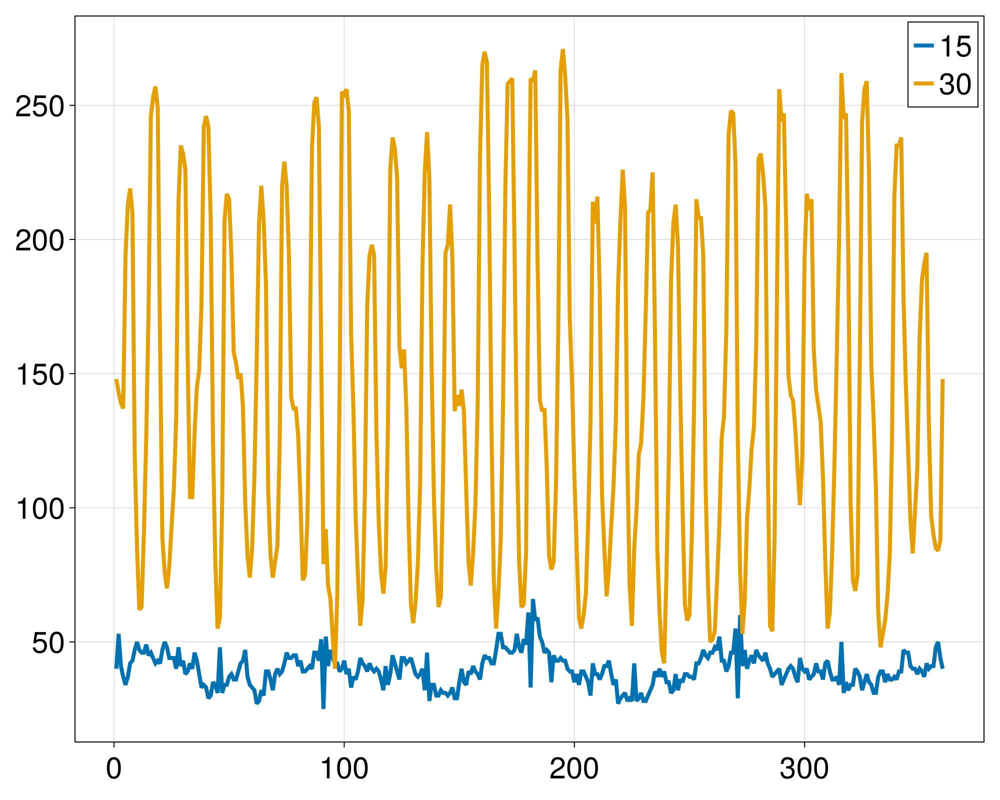

In [117]:
fig2 = Figure()
ax = Axis(fig2[1,1])
lines!(ax, data_a.metric_OG[3200+23], label = "15")
lines!(ax, data_a_30.metric_OG[3200+23], label= "30")
axislegend(ax)
fig2

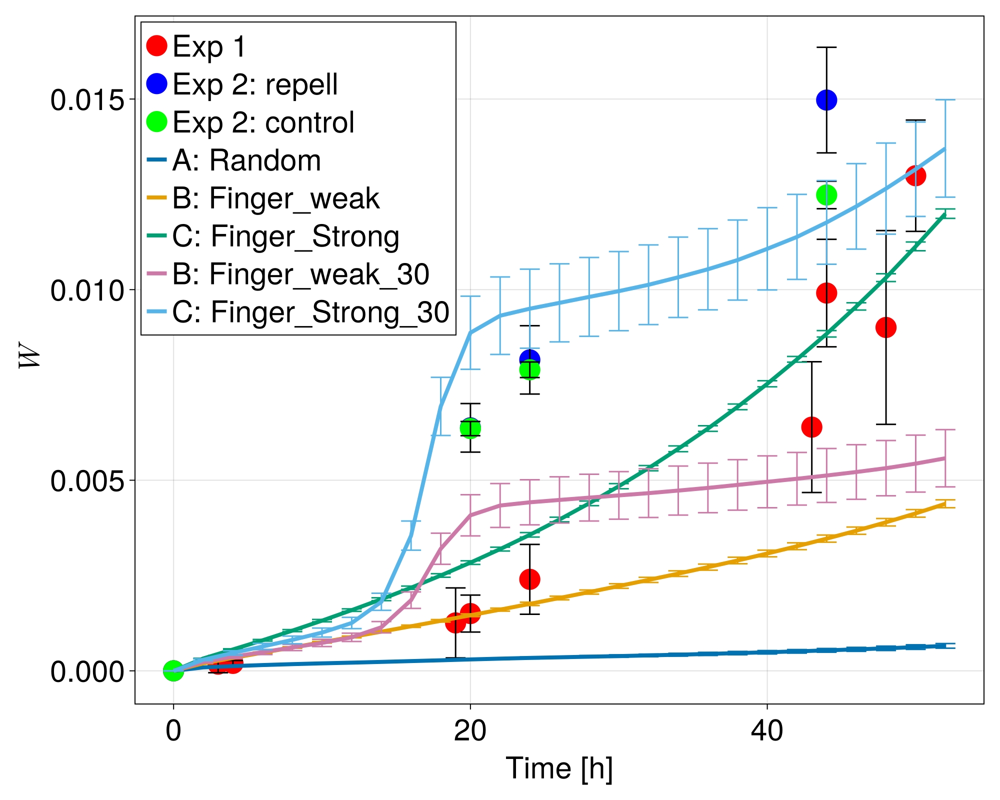

In [133]:
fig31 = Figure()

model_name = ["A: Random","B: Finger_weak","C: Finger_Strong","B: Finger_weak_30","C: Finger_Strong_30"] 

ax = CairoMakie.Axis(fig31[1,1])
scatter!(ax,roughness_angular_max_r.time,roughness_angular_max_r.roughness_OG, color = "red", markersize = markersize)
errorbars!(ax,roughness_angular_max_r.time,roughness_angular_max_r.roughness_OG, roughness_angular_max_r.roughness_OG_std,color = :black)
ax.xlabel ="Time [h]"
ax.ylabel = L"W"
j = 1


## evo active 
scatter!(ax,roughness_angular_evo_active.time,roughness_angular_evo_active.roughness_OG, markersize = markersize, color = "blue", label ="Exp 2: repell")
errorbars!(ax,roughness_angular_evo_active.time,roughness_angular_evo_active.roughness_OG, roughness_angular_evo_active.roughness_OG_std, color = :black)

## evo passive
scatter!(ax,roughness_angular_evo_passive.time,roughness_angular_evo_passive.roughness_OG, markersize = markersize, color = green, label ="Exp 2: control")
errorbars!(ax,roughness_angular_evo_passive.time,roughness_angular_evo_passive.roughness_OG, roughness_angular_evo_passive.roughness_OG_std, color = :black)



for (k, i) in pairs(groupby(roughness_angular_max_single,:data_set))
    #lines!(ax, i.time, i.roughness_angu, label = mk_label(k.data_set))
    lines!(ax, i.time, i.roughness_angu, label = model_name[j],linewidth = 4)
    errorbars!(ax, i.time, i.roughness_angu,i.roughness_angu_std )
    j += 1
end

for (k, i) in pairs(groupby(roughness_angular_right_single_30,:data_set))
    if i.data_set[1][1:2] == "Ra"
        continue
        lines!(ax, i.time, i.pair_og, label = model_name[j],linewidth = 4)
        errorbars!(ax, i.time, i.pair_og,i.pair_og_stdd )
    else
       lines!(ax, i.time, i.roughness_angu, label = model_name[j])
    #scatterlines!(ax, i.time, i.roughness_angu, label = model_name[j],linewidth = 4,markersize  = 10)
    errorbars!(ax, i.time, i.roughness_angu,i.roughness_angu_std *.5)
    end
    j += 1
end



axislegend(ax, position= :lt)
save(joinpath(path,"Comparision_RMS_64_controll_repell.pdf"),fig31)
fig31

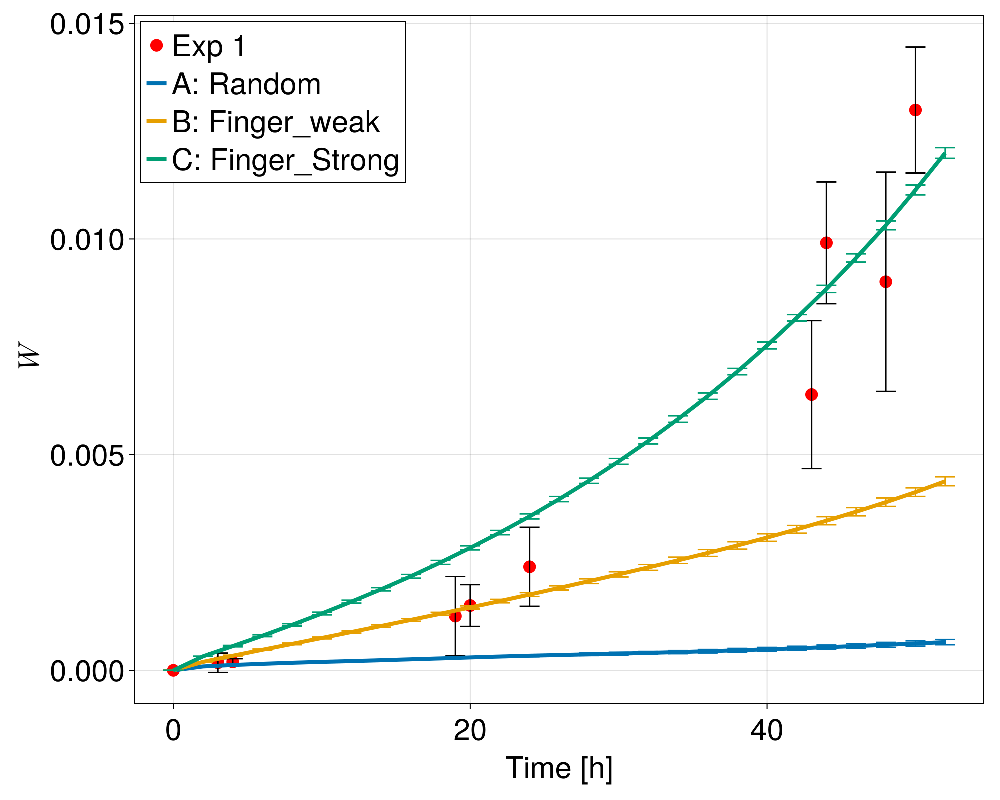

In [120]:
fig30 = Figure()

model_name = ["A: Random","B: Finger_weak","C: Finger_Strong","B: Finger_weak_30","C: Finger_Strong_30"] 

ax = CairoMakie.Axis(fig30[1,1])
scatter!(ax,roughness_angular_max_r.time,roughness_angular_max_r.roughness_OG, color = "red")
errorbars!(ax,roughness_angular_max_r.time,roughness_angular_max_r.roughness_OG, roughness_angular_max_r.roughness_OG_std,color = :black)
ax.xlabel ="Time [h]"
ax.ylabel = L"W"
j = 1

"""
## evo active 
scatter!(ax,roughness_angular_evo_active.time,roughness_angular_evo_active.roughness_OG, markersize = 20, color = "blue", label ="Exp 2: repell")
errorbars!(ax,roughness_angular_evo_active.time,roughness_angular_evo_active.roughness_OG, roughness_angular_evo_active.roughness_OG_std, color = :black)

## evo passive
scatter!(ax,roughness_angular_evo_passive.time,roughness_angular_evo_passive.roughness_OG, markersize = 20, color = "green", label ="Exp 2: control")
errorbars!(ax,roughness_angular_evo_passive.time,roughness_angular_evo_passive.roughness_OG, roughness_angular_evo_passive.roughness_OG_std, color = :black)
"""


for (k, i) in pairs(groupby(roughness_angular_max_single,:data_set))
    #lines!(ax, i.time, i.roughness_angu, label = mk_label(k.data_set))
    lines!(ax, i.time, i.roughness_angu, label = model_name[j],linewidth = 4)
    errorbars!(ax, i.time, i.roughness_angu,i.roughness_angu_std )
    j += 1
end
"""
for (k, i) in pairs(groupby(roughness_angular_right_single_30,:data_set))
    if i.data_set[1][1:2] == "Ra"
        continue
        lines!(ax, i.time, i.pair_og, label = model_name[j],linewidth = 4)
        errorbars!(ax, i.time, i.pair_og,i.pair_og_stdd )
    else
       lines!(ax, i.time, i.roughness_angu, label = model_name[j])
    #scatterlines!(ax, i.time, i.roughness_angu, label = model_name[j],linewidth = 4,markersize  = 10)
    errorbars!(ax, i.time, i.roughness_angu,i.roughness_angu_std *.5)
    end
    j += 1
end
"""


axislegend(ax, position= :lt)
save(joinpath(path,"Comparision_RMS_64.pdf"),fig30)
fig30

## Fourier Transform on data set 

In [121]:
fft_data = @chain data_a begin 
    @transform(:fourier_conv = (fft.(:metric_cov)), :fourier_OG = (fft.(:metric_OG)))
    @transform(:abs_cov = [abs.(x[2:360÷2]) for x in :fourier_conv], :abs_OG = [abs.(x[2:360÷2]) for x in :fourier_OG])
    @transform(:abs_cov_n = :abs_cov./:OG_size, :abs_OG_n = :abs_OG ./ :OG_size)

end
first(fft_data)

fft_data_30 = @chain data_a_30 begin 
    @transform(:fourier_conv = (fft.(:metric_cov)), :fourier_OG = (fft.(:metric_OG)))
    @transform(:abs_cov = [abs.(x[2:360÷2]) for x in :fourier_conv], :abs_OG = [abs.(x[2:360÷2]) for x in :fourier_OG])
    @transform(:abs_cov_n = :abs_cov./:OG_size, :abs_OG_n = :abs_OG ./ :OG_size)

end

fft_data_all = @chain data_a begin 
    @transform(:fourier_conv = (fft.(:metric_cov)), :fourier_OG = (fft.(:metric_OG)))
    @transform(:abs_cov = [abs.(x[1:360÷2]) for x in :fourier_conv], :abs_OG = [abs.(x[1:360÷2]) for x in :fourier_OG])
    @transform(:abs_cov_n = :abs_cov./:OG_size, :abs_OG_n = :abs_OG ./ :OG_size)

end

fft_data_first = @chain data_a begin 
    @transform(:fourier_conv = (fft.(:metric_cov)), :fourier_OG = (fft.(:metric_OG)))
    @transform(:abs_cov = [abs.(x[1]) for x in :fourier_conv], :abs_OG = [abs.(x[1]) for x in :fourier_OG])
    @transform(:abs_cov_n = :abs_cov./:OG_size, :abs_OG_n = :abs_OG ./ :OG_size)

end
first(fft_data)

fft_data_r = @chain data_full begin 
    @transform(:fourier_conv = (fft.(:metric_cov)), :fourier_OG = (fft.(:metric_OG)))
    @transform(:abs_cov = [abs.(x[2:360÷2]) for x in :fourier_conv], :abs_OG = [abs.(x[2:360÷2]) for x in :fourier_OG])
    @transform(:abs_cov_n = :abs_cov./:OG_size, :abs_OG_n = :abs_OG ./ :OG_size)

end

fft_data_r_all = @chain data_full begin 
    @transform(:fourier_conv = (fft.(:metric_cov)), :fourier_OG = (fft.(:metric_OG)))
    @transform(:abs_cov = [abs.(x[1:360÷2]) for x in :fourier_conv], :abs_OG = [abs.(x[1:360÷2]) for x in :fourier_OG])
    @transform(:abs_cov_n = :abs_cov./:OG_size, :abs_OG_n = :abs_OG ./ :OG_size)

end


fft_data_r_first = @chain data_full begin 
    @transform(:fourier_conv = (fft.(:metric_cov)), :fourier_OG = (fft.(:metric_OG)))
    @transform(:abs_cov = [abs.(x[1]) for x in :fourier_conv], :abs_OG = [abs.(x[1]) for x in :fourier_OG])
    @transform(:abs_cov_n = :abs_cov./:OG_size, :abs_OG_n = :abs_OG ./ :OG_size)

end
first(fft_data_r_first)

fft_data_evo_active = @chain data_evo_active begin 
    @transform(:fourier_conv = (fft.(:metric_cov)), :fourier_OG = (fft.(:metric_OG)))
    @transform(:abs_cov = [abs.(x[2:360÷2]) for x in :fourier_conv], :abs_OG = [abs.(x[2:360÷2]) for x in :fourier_OG])
    @transform(:abs_cov_n = :abs_cov./:OG_size, :abs_OG_n = :abs_OG ./ :OG_size)

end

fft_data_evo_passive = @chain data_evo_passive begin 
    @transform(:fourier_conv = (fft.(:metric_cov)), :fourier_OG = (fft.(:metric_OG)))
    @transform(:abs_cov = [abs.(x[2:360÷2]) for x in :fourier_conv], :abs_OG = [abs.(x[2:360÷2]) for x in :fourier_OG])
    @transform(:abs_cov_n = :abs_cov./:OG_size, :abs_OG_n = :abs_OG ./ :OG_size)

end
;

In [122]:
abs_fftw = @chain fft_data begin 
    groupby(:time)
    @combine(:abs_og = mean(sum.(:abs_OG)) , :abs_cov = mean(sum.(:abs_cov)),:abs_og_n = mean(sum.(:abs_OG_n)),:abs_cov_n = mean(sum.(:abs_cov_n))
    ,:abs_og_std = std(sum.(:abs_OG)), :abs_cov_std = std(sum.(:abs_cov)),:abs_og_n_std = std(sum.(:abs_OG_n)),:abs_cov_n_std = std(sum.(:abs_cov_n)))
end
first(abs_fftw,3)

abs_fftw_30 = @chain fft_data_30 begin 
    groupby(:time)
    @combine(:abs_og = mean(sum.(:abs_OG)) , :abs_cov = mean(sum.(:abs_cov)),:abs_og_n = mean(sum.(:abs_OG_n)),:abs_cov_n = mean(sum.(:abs_cov_n))
    ,:abs_og_std = std(sum.(:abs_OG)), :abs_cov_std = std(sum.(:abs_cov)),:abs_og_n_std = std(sum.(:abs_OG_n)),:abs_cov_n_std = std(sum.(:abs_cov_n)))
end

abs_fftw_single = @chain fft_data begin 
    groupby([:time,:data_set])
    @combine(:abs_og = mean(sum.(:abs_OG)) , :abs_cov = mean(sum.(:abs_cov)),:abs_og_n = mean(sum.(:abs_OG_n)),:abs_cov_n = mean(sum.(:abs_cov_n)),
    :abs_og_std = std(sum.(:abs_OG)), :abs_cov_std = std(sum.(:abs_cov)),:abs_og_n_std = std(sum.(:abs_OG_n)),:abs_cov_n_std = std(sum.(:abs_cov_n)))
end

abs_fftw_single_30  = @chain fft_data_30 begin 
    groupby([:time,:data_set])
    @combine(:abs_og = mean(sum.(:abs_OG)) , :abs_cov = mean(sum.(:abs_cov)),:abs_og_n = mean(sum.(:abs_OG_n)),:abs_cov_n = mean(sum.(:abs_cov_n)),
    :abs_og_std = std(sum.(:abs_OG)), :abs_cov_std = std(sum.(:abs_cov)),:abs_og_n_std = std(sum.(:abs_OG_n)),:abs_cov_n_std = std(sum.(:abs_cov_n)))
end
last(abs_fftw_single,3)

Row,time,data_set,abs_og,abs_cov,abs_og_n,abs_cov_n,abs_og_std,abs_cov_std,abs_og_n_std,abs_cov_n_std
,Int64,String,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,48,Finger_strong 2024_04_23,2.10413e5,2.09636e5,10.2197,10.1819,10662.7,10665.9,0.517885,0.518037
2,50,Finger_strong 2024_04_23,2.26069e5,2.25291e5,10.9801,10.9423,11533.2,11534.5,0.560164,0.560227
3,52,Finger_strong 2024_04_23,2.42013e5,2.41231e5,11.7545,11.7165,11431.4,11409.7,0.555218,0.554164


In [123]:
abs_fftw_all = @chain fft_data_all begin 
    groupby(:time)
    @combine(:abs_og = mean(sum.(:abs_OG)) , :abs_cov = mean(sum.(:abs_cov)),:abs_og_n = mean(sum.(:abs_OG_n)),:abs_cov_n = mean(sum.(:abs_cov_n))
    ,:abs_og_std = std(sum.(:abs_OG)), :abs_cov_std = std(sum.(:abs_cov)),:abs_og_n_std = std(sum.(:abs_OG_n)),:abs_cov_n_std = std(sum.(:abs_cov_n)))
end
first(abs_fftw,3)

abs_fftw_single_all = @chain fft_data_all begin 
    groupby([:time,:data_set])
    @combine(:abs_og = mean(sum.(:abs_OG)) , :abs_cov = mean(sum.(:abs_cov)),:abs_og_n = mean(sum.(:abs_OG_n)),:abs_cov_n = mean(sum.(:abs_cov_n)),
    :abs_og_std = std(sum.(:abs_OG)), :abs_cov_std = std(sum.(:abs_cov)),:abs_og_n_std = std(sum.(:abs_OG_n)),:abs_cov_n_std = std(sum.(:abs_cov_n)))
end

last(abs_fftw_single_all,3)

Row,time,data_set,abs_og,abs_cov,abs_og_n,abs_cov_n,abs_og_std,abs_cov_std,abs_og_n_std,abs_cov_n_std
,Int64,String,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,48,Finger_strong 2024_04_23,2.73959e5,2.73253e5,13.3061,13.2718,10662.7,10670.0,0.517885,0.518236
2,50,Finger_strong 2024_04_23,2.94697e5,2.93988e5,14.3133,14.2789,11533.2,11538.1,0.560164,0.560403
3,52,Finger_strong 2024_04_23,3.1603e5,3.15315e5,15.3495,15.3147,11431.4,11411.3,0.555218,0.554241


In [124]:
abs_fftw_all_first = @chain fft_data_first begin 
    groupby(:time)
    @combine(:abs_og = mean(sum.(:abs_OG)) , :abs_cov = mean(sum.(:abs_cov)),:abs_og_n = mean(sum.(:abs_OG_n)),:abs_cov_n = mean(sum.(:abs_cov_n))
    ,:abs_og_std = std(sum.(:abs_OG)), :abs_cov_std = std(sum.(:abs_cov)),:abs_og_n_std = std(sum.(:abs_OG_n)),:abs_cov_n_std = std(sum.(:abs_cov_n)))
end
first(abs_fftw,3)

abs_fftw_single_all_first = @chain fft_data_first begin 
    groupby([:time,:data_set])
    @combine(:abs_og = mean(sum.(:abs_OG)) , :abs_cov = mean(sum.(:abs_cov)),:abs_og_n = mean(sum.(:abs_OG_n)),:abs_cov_n = mean(sum.(:abs_cov_n)),
    :abs_og_std = std(sum.(:abs_OG)), :abs_cov_std = std(sum.(:abs_cov)),:abs_og_n_std = std(sum.(:abs_OG_n)),:abs_cov_n_std = std(sum.(:abs_cov_n)))
end

last(abs_fftw_single_all,3)

Row,time,data_set,abs_og,abs_cov,abs_og_n,abs_cov_n,abs_og_std,abs_cov_std,abs_og_n_std,abs_cov_n_std
,Int64,String,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,48,Finger_strong 2024_04_23,2.73959e5,2.73253e5,13.3061,13.2718,10662.7,10670.0,0.517885,0.518236
2,50,Finger_strong 2024_04_23,2.94697e5,2.93988e5,14.3133,14.2789,11533.2,11538.1,0.560164,0.560403
3,52,Finger_strong 2024_04_23,3.1603e5,3.15315e5,15.3495,15.3147,11431.4,11411.3,0.555218,0.554241


In [125]:
abs_fftw_r_first = @chain fft_data_r_first begin 
    groupby(:time)
    @combine(:abs_og = mean(sum.(:abs_OG)) , :abs_cov = mean(sum.(:abs_cov)),:abs_og_n = mean(sum.(:abs_OG_n)),:abs_cov_n = mean(sum.(:abs_cov_n)),:abs_og_n_std = std(sum.(:abs_OG_n)) )
end
last(abs_fftw_r_all,5)

Row,time,abs_og,abs_cov,abs_og_n,abs_cov_n,abs_og_n_std
,Int64,Float64,Float64,Float64,Float64,Float64
1,24,1.02402e5,92355.5,5.06619,4.56394,1.93139
2,43,3.60624e5,3.47992e5,12.7941,12.3453,3.76237
3,44,3.06037e5,2.94734e5,20.0502,19.3104,2.83146
4,48,3.81288e5,3.71012e5,18.3418,17.8712,5.33151
5,50,4.13647e5,4.07491e5,24.5824,24.2166,2.8063


In [126]:
abs_fftw_r_all = @chain fft_data_r_all begin 
    groupby(:time)
    @combine(:abs_og = mean(sum.(:abs_OG)) , :abs_cov = mean(sum.(:abs_cov)),:abs_og_n = mean(sum.(:abs_OG_n)),:abs_cov_n = mean(sum.(:abs_cov_n)),:abs_og_n_std = std(sum.(:abs_OG_n)) )
end
last(abs_fftw_r_all,5)

Row,time,abs_og,abs_cov,abs_og_n,abs_cov_n,abs_og_n_std
,Int64,Float64,Float64,Float64,Float64,Float64
1,24,1.02402e5,92355.5,5.06619,4.56394,1.93139
2,43,3.60624e5,3.47992e5,12.7941,12.3453,3.76237
3,44,3.06037e5,2.94734e5,20.0502,19.3104,2.83146
4,48,3.81288e5,3.71012e5,18.3418,17.8712,5.33151
5,50,4.13647e5,4.07491e5,24.5824,24.2166,2.8063


In [127]:
abs_fftw_r = @chain fft_data_r begin 
    groupby(:time)
    @combine(:abs_og = mean(sum.(:abs_OG)) , :abs_cov = mean(sum.(:abs_cov)),:abs_og_n = mean(sum.(:abs_OG_n)),:abs_cov_n = mean(sum.(:abs_cov_n)),:abs_og_n_std = std(sum.(:abs_OG_n)) )
end
last(abs_fftw_r,5)

abs_fftw_evo_active = @chain fft_data_evo_active begin 
    groupby(:time)
    @combine(:abs_og = mean(sum.(:abs_OG)) , :abs_cov = mean(sum.(:abs_cov)),:abs_og_n = mean(sum.(:abs_OG_n)),:abs_cov_n = mean(sum.(:abs_cov_n)),:abs_og_n_std = std(sum.(:abs_OG_n)) )
end

abs_fftw_evo_passive = @chain fft_data_evo_passive begin 
    groupby(:time)
    @combine(:abs_og = mean(sum.(:abs_OG)) , :abs_cov = mean(sum.(:abs_cov)),:abs_og_n = mean(sum.(:abs_OG_n)),:abs_cov_n = mean(sum.(:abs_cov_n)),:abs_og_n_std = std(sum.(:abs_OG_n)) )
end

Row,time,abs_og,abs_cov,abs_og_n,abs_cov_n,abs_og_n_std
,Int64,Float64,Float64,Float64,Float64,Float64
1,0,0.0,14176.0,0.0,0.224261,0.0
2,20,7.3005e5,7.06771e5,11.55,11.1826,0.494469
3,24,894873.0,876854.0,14.1587,13.8746,0.730116
4,44,1.41927e6,1.40945e6,22.4592,22.305,1.7263


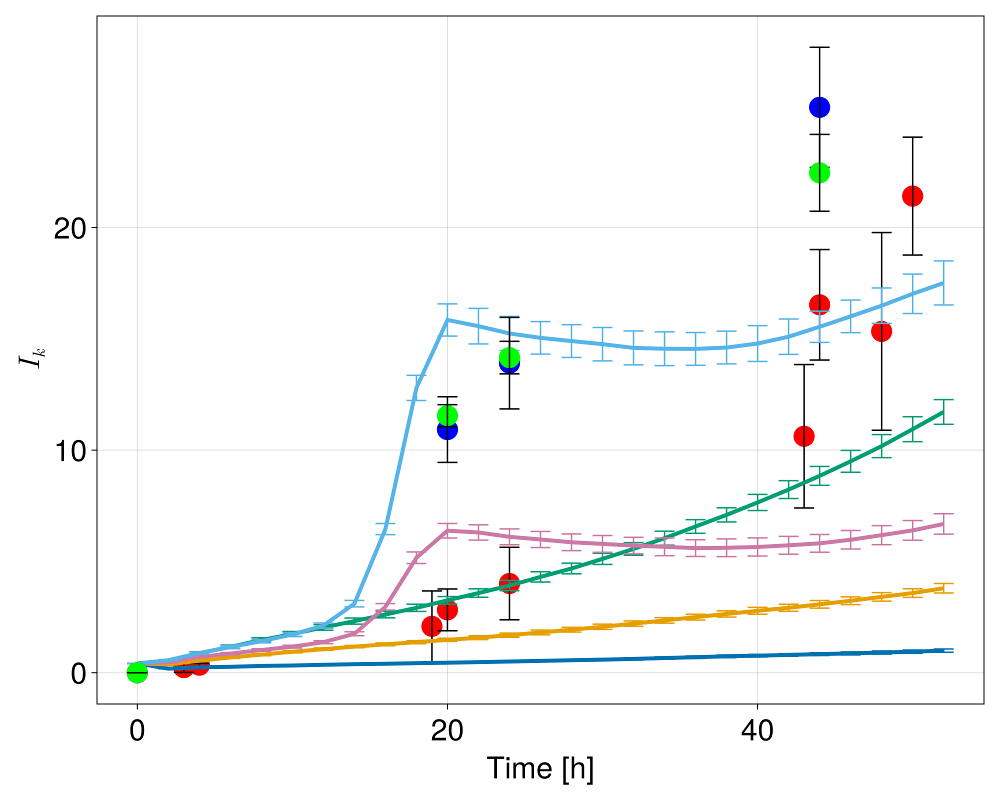

In [134]:
fig5 = Figure()
model_name = ["A: Random","B: Finger_weak","C: Finger_Strong","B: Finger_weak_30","C: Finger_Strong_30"] 

ax = CairoMakie.Axis(fig5[1,1])
scatter!(ax,abs_fftw_r.time, abs_fftw_r.abs_og_n, color = "red", markersize = markersize) 
errorbars!(ax, abs_fftw_r.time, abs_fftw_r.abs_og_n , abs_fftw_r.abs_og_n_std, color = :black)
ax.xlabel ="Time [h]"
ax.ylabel = L"I_{k}"
j = 1
for (k, i) in pairs(groupby(abs_fftw_single,:data_set))
    #lines!(ax, i.time, i.abs_og_n, label = mk_label(k.data_set))
    lines!(ax, i.time, i.abs_cov_n, label = model_name[j],linewidth = 4)
    errorbars!(ax, i.time, i.abs_cov_n,i.abs_og_n_std )
    j += 1
end

for (k, i) in pairs(groupby(abs_fftw_single_30,:data_set))
    if i.data_set[1][1:2] == "Ra"
        continue
        lines!(ax, i.time, i.pair_og, label = model_name[j],linewidth = 4)
        errorbars!(ax, i.time, i.pair_og,i.pair_og_stdd )
    else
    #lines!(ax, i.time, i.abs_og_n, label = mk_label(k.data_set))
        lines!(ax, i.time, i.abs_cov_n, label = model_name[j],linewidth = 4)
        errorbars!(ax, i.time, i.abs_cov_n,i.abs_og_n_std )
    end
    j += 1
end

## evo active
scatter!(ax,abs_fftw_evo_active.time, abs_fftw_evo_active.abs_og_n, markersize = markersize, color = "blue", label ="repell")
errorbars!(ax,abs_fftw_evo_active.time, abs_fftw_evo_active.abs_og_n, abs_fftw_evo_active.abs_og_n_std, color = :black)

## evo passive
scatter!(ax,abs_fftw_evo_passive.time, abs_fftw_evo_passive.abs_og_n, markersize = markersize, color = green, label ="controll")
errorbars!(ax,abs_fftw_evo_passive.time, abs_fftw_evo_passive.abs_og_n, abs_fftw_evo_passive.abs_og_n_std, color = :black)

#axislegend(ax, position = :lt)
save(joinpath(path,"Comparision_fourier_coeff_controll_repell.pdf"),fig5)
fig5

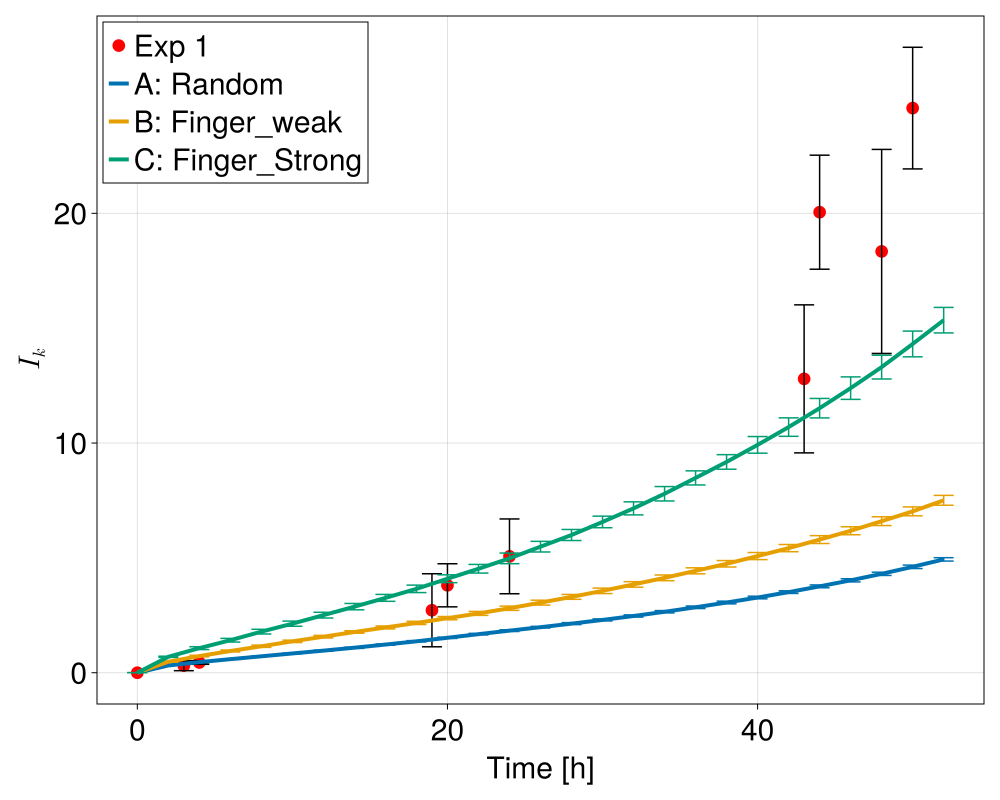

In [65]:
fig6 = Figure()
model_name = ["A: Random","B: Finger_weak","C: Finger_Strong","A: Random","B: Finger_weak_30","C: Finger_Strong_30"] 
ax = CairoMakie.Axis(fig6[1,1])
scatter!(ax,abs_fftw_r_all.time, abs_fftw_r_all.abs_og_n, color = "red") 
errorbars!(ax, abs_fftw_r_all.time, abs_fftw_r_all.abs_og_n , abs_fftw_r.abs_og_n_std, color = :black)
ax.xlabel ="Time [h]"
ax.ylabel = L"I_{k}"
j = 1
for (k, i) in pairs(groupby(abs_fftw_single_all,:data_set))
    lines!(ax, i.time, i.abs_og_n, label = model_name[j])
    errorbars!(ax, i.time, i.abs_og_n,i.abs_og_n_std )
    j += 1
end
axislegend(ax, position = :lt)
save(joinpath(path,"Comparision_fourier_coeff.pdf"),fig6)
fig6

In [66]:
abs_fftw_single_all_first

Row,time,data_set,abs_og,abs_cov,abs_og_n,abs_cov_n,abs_og_std,abs_cov_std,abs_og_n_std,abs_cov_n_std
,Int64,String,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,0,Random 2024_04_23,0.0,20589.0,0.0,1.0,0.0,0.0,0.0,0.0
2,2,Random 2024_04_23,1244.1,607.164,0.0604255,0.0294897,0.662135,28.3123,3.21596e-5,0.00137512
3,4,Random 2024_04_23,2562.98,876.367,0.124483,0.0425648,0.725951,60.6287,3.52592e-5,0.00294471
4,6,Random 2024_04_23,3961.97,954.773,0.192431,0.046373,0.741753,71.5988,3.60266e-5,0.00347752
5,8,Random 2024_04_23,5444.94,1145.32,0.264459,0.0556278,0.672871,67.2255,3.26811e-5,0.00326512
6,10,Random 2024_04_23,7017.95,1225.61,0.340859,0.0595274,0.761881,93.3783,3.70043e-5,0.00453535
7,12,Random 2024_04_23,8686.07,1397.23,0.421879,0.0678631,0.700771,151.643,3.40362e-5,0.00736524
8,14,Random 2024_04_23,10454.0,1529.61,0.507746,0.0742926,0.704274,101.74,3.42063e-5,0.00494148
9,16,Random 2024_04_23,12329.0,1640.6,0.598815,0.0796834,0.737052,109.6,3.57983e-5,0.00532321


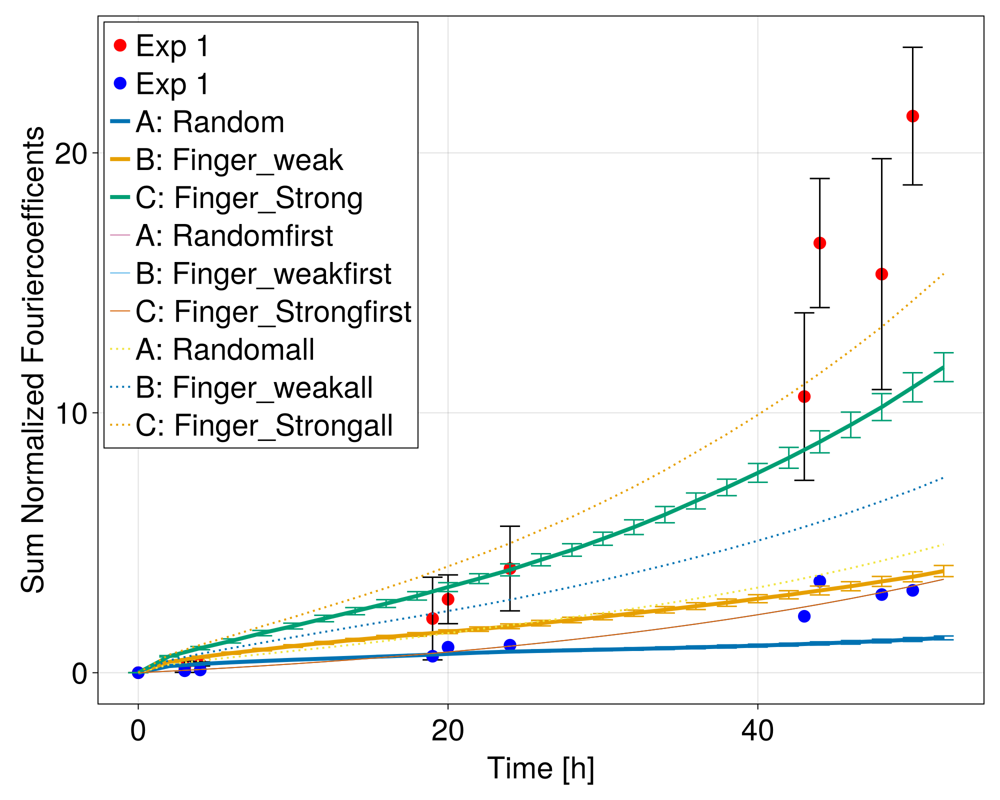

In [67]:
fig7 = Figure()
ax = CairoMakie.Axis(fig7[1,1])
scatter!(ax,abs_fftw_r.time, abs_fftw_r.abs_og_n, color = "red") 
errorbars!(ax, abs_fftw_r.time, abs_fftw_r.abs_og_n , abs_fftw_r.abs_og_n_std, color = :black)

scatter!(ax,abs_fftw_r_first.time, abs_fftw_r_first.abs_og_n, color = "blue") 

ax.xlabel ="Time [h]"
ax.ylabel ="Sum Normalized Fouriercoefficents"


j = 1
for (k, i) in pairs(groupby(abs_fftw_single,:data_set))
    #lines!(ax, i.time, i.abs_og_n, label = mk_label(k.data_set))
    lines!(ax, i.time, i.abs_og_n, label = model_name[j],linewidth = 4)
    errorbars!(ax, i.time, i.abs_og_n,i.abs_og_n_std )
    j += 1
end

j = 1
for (k, i) in pairs(groupby(abs_fftw_single_all_first,:data_set))
    #lines!(ax, i.time, i.abs_og_n, label = mk_label(k.data_set))
    lines!(ax, i.time, i.abs_og_n, label = model_name[j]*"first",linewidth = 1)
    #errorbars!(ax, i.time, i.abs_og_n,i.abs_og_n_std )
    j += 1
end


j = 1
for (k, i) in pairs(groupby(abs_fftw_single_all,:data_set))
    #lines!(ax, i.time, i.abs_og_n, label = mk_label(k.data_set))
    lines!(ax, i.time, i.abs_og_n, label = model_name[j]*"all",linewidth = 2, linestyle = :dot)
    #errorbars!(ax, i.time, i.abs_og_n,i.abs_og_n_std )
    j += 1
end

axislegend(ax, position = :lt)
save(joinpath(path,"Relation_fourier_coeff_64.pdf"),fig7)
fig7

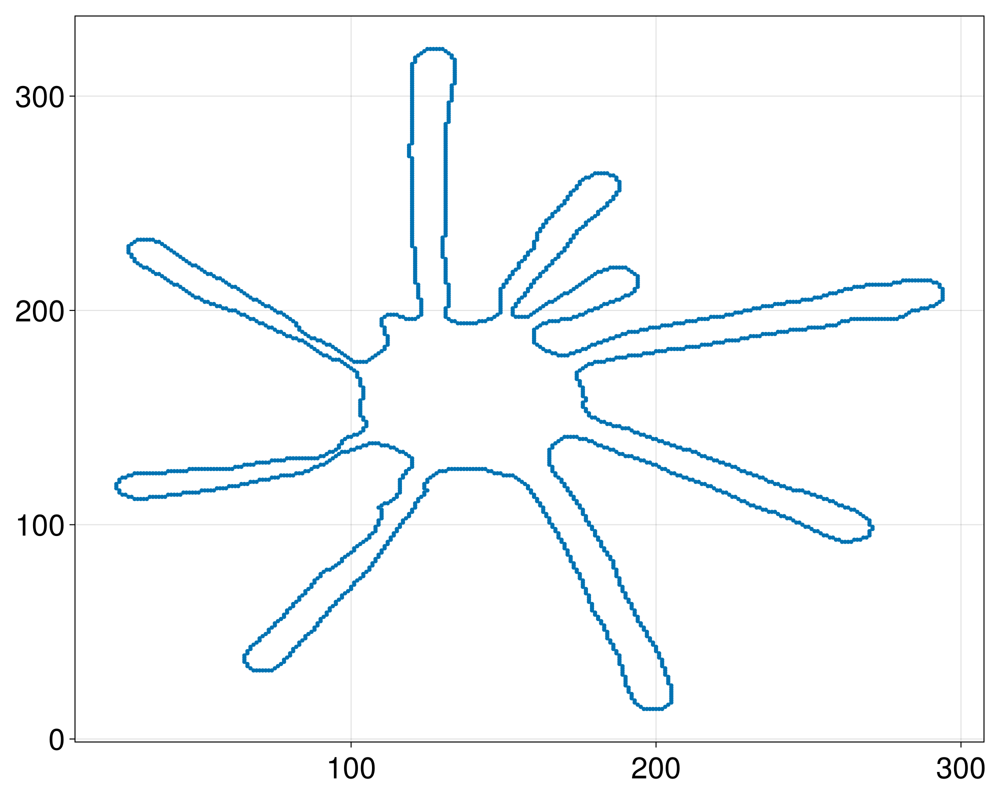

In [69]:
scatter(Point2f.(Tuple.(data_r.border_points[3])), markersize = 6)

In [70]:
all_frequ = vcat(filter_fourier_beta.(fft_data.abs_OG_n)...);


all_frequ_30 = vcat(filter_fourier_beta.(fft_data_30.abs_OG_n)...);
fft_data_r_old = @subset(fft_data_r, :time .> 10)
fft_data_a_old = @subset(fft_data, :time .> 10);

In [71]:
histo_data_r = vcat(find_freq.(filter_fourier_beta.(fft_data_r.abs_OG_n, b  =0.8))...);



histo_data_evo_active = vcat(find_freq.(filter_fourier_beta.(fft_data_evo_active.abs_OG_n, b  =0.8))...);
histo_data_evo_passive = vcat(find_freq.(filter_fourier_beta.(fft_data_evo_passive.abs_OG_n, b  =0.8))...);

In [72]:
median(histo_data_r)

13.0

In [73]:
histo_data_evo_active

3-element Vector{Int64}:
 21
 21
 21

In [74]:
mean(histo_data_r)


13.209756097560975

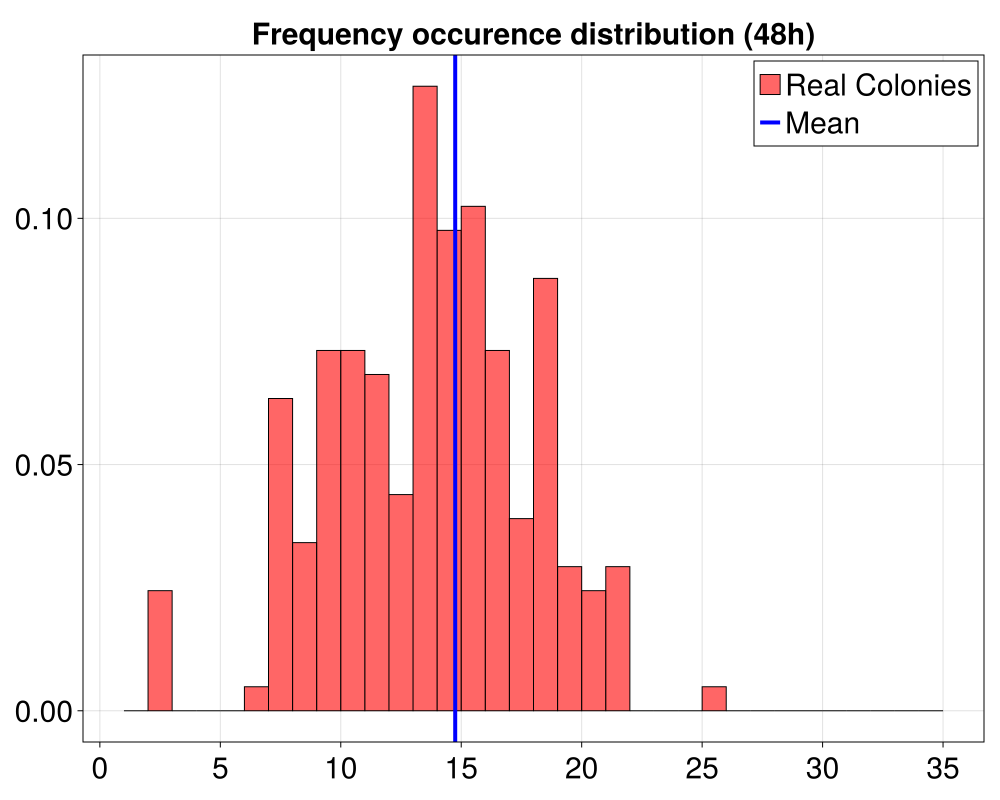

In [75]:
histo_data_a_vec = []
color_vec =[:green, :blue, :yellow, :orange, :purple, :black, :pink, :cyan, :magenta]



hans = Figure()
ax = Axis(hans[1,1])
#ylims!(ax,0,0.09)
histi = hist!(ax,histo_data_r, bins = 1:35,strokewidth = 1, color = (:red, 0.6), label = "Real Colonies",normalization = :pdf)
c = 1

"""
for (k,i) in pairs(groupby(fft_data_a_old,:data_set))
    push!(histo_data_a_vec, vcat(find_freq.(filter_fourier_beta.(i.abs_OG_n, b  =0.5))...))
    hist!(ax,histo_data_a_vec[end], bins = 1:40,strokewidth = 1, color = (color_vec[c], 0.3), label = mk_label(k.data_set),normalization = :pdf)
    c += 1
end
"""

vlines!(ax, 14.75, ymin = 0.00,ymax = 1.0, color = :blue, linewidth = 4, label = "Mean")
ax.title =  "Frequency occurence distribution (48h)"
ax.xticks = 0:5:35
axislegend( position = :rt,)

save(joinpath(path,"frequ_dist_64.pdf"),hans)
hans

### Size increase measure in pixel in circular metric

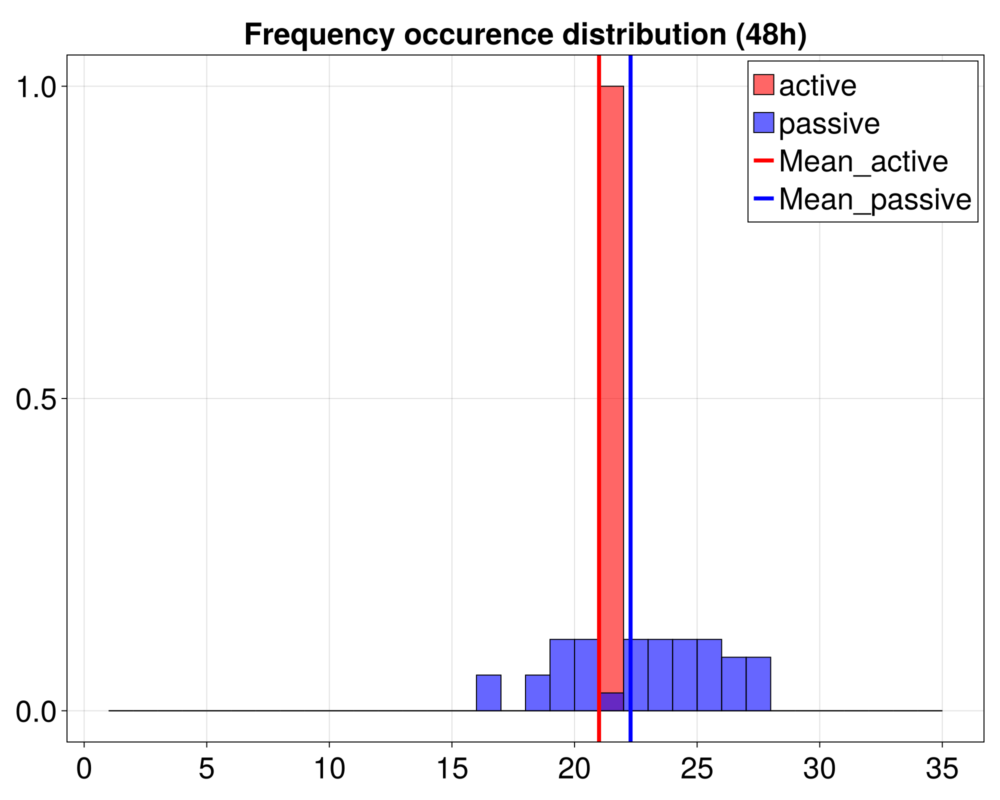

In [76]:
histo_data_a_vec = []
color_vec =[:green, :blue, :yellow, :orange, :purple, :black, :pink, :cyan, :magenta]



hans = Figure()
ax = Axis(hans[1,1])
#ylims!(ax,0,0.09)
histi = hist!(ax,histo_data_evo_active, bins = 1:35,strokewidth = 1, color = (:red, 0.6), label = "active",normalization = :pdf)
histi2 = hist!(ax,histo_data_evo_passive, bins = 1:35,strokewidth = 1, color = (:blue, 0.6), label = "passive",normalization = :pdf)
c = 1

"""
for (k,i) in pairs(groupby(fft_data_a_old,:data_set))
    push!(histo_data_a_vec, vcat(find_freq.(filter_fourier_beta.(i.abs_OG_n, b  =0.5))...))
    hist!(ax,histo_data_a_vec[end], bins = 1:40,strokewidth = 1, color = (color_vec[c], 0.3), label = mk_label(k.data_set),normalization = :pdf)
    c += 1
end
"""

vlines!(ax, mean(histo_data_evo_active), ymin = 0.00,ymax = 1.0, color = :red, linewidth = 4, label = "Mean_active")
vlines!(ax, mean(histo_data_evo_passive), ymin = 0.00,ymax = 1.0, color = :blue, linewidth = 4, label = "Mean_passive")
ax.title =  "Frequency occurence distribution (48h)"
ax.xticks = 0:5:35
axislegend( position = :rt,)

#save(joinpath(path,"frequ_dist_64.pdf"),hans)
hans

In [78]:
first(data_full)

Row,data_set,colony,time,metric_OG,metric_cov,pair_OG,pair_cov,OG_size,border_points,Parameters
,String,String,Int64,Array…,Array…,Array…,Array…,Int64,Array…,paramete…
1,14_06_23_stacked_full_res 2024_04_16,Kolonie-1 seg.tif,0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0 … 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[54, 36, 51, 46, 47, 47, 48, 48, 46, 51 … 44, 51, 46, 47, 48, 47, 47, 46, 49, 54]","[5536, 5551, 5566, 5468, 5558, 5554, 5569, 5531, 5535, 5454 … 5430, 5578, 5541, 5593, 5476, 5592, 5440, 5658, 5467, 5695]","[5606, 5518, 5634, 5688, 5395, 5464, 5459, 5502, 5699, 5657 … 5601, 5573, 5550, 5598, 5576, 5641, 5630, 5589, 5474, 5570]",16675,"CartesianIndex{2}[CartesianIndex(1081, 630), CartesianIndex(1082, 630), CartesianIndex(1083, 630), CartesianIndex(1084, 630), CartesianIndex(1075, 631), CartesianIndex(1076, 631), CartesianIndex(1077, 631), CartesianIndex(1078, 631), CartesianIndex(1079, 631), CartesianIndex(1080, 631) … CartesianIndex(1084, 775), CartesianIndex(1085, 775), CartesianIndex(1086, 775), CartesianIndex(1087, 775), CartesianIndex(1088, 775), CartesianIndex(1089, 775), CartesianIndex(1090, 775), CartesianIndex(1091, 775), CartesianIndex(1092, 775), CartesianIndex(1093, 775)]","parameters([0.0, 4.0, 20.0, 24.0, 44.0, 48.0], 0.8, 0.8, 0.4, 360, 2000000, 300, [1644, 1588], 6, 82, [822, 794], 0.029717, #5, 0.01, [0 1 0; 1 -4 1; 0 1 0], 6, [""Kolonie-1 seg.tif"", ""Kolonie-3 seg.tif"", ""Kolonie-5 seg.tif"", ""Kolonie-6 seg.tif"", ""Kolonie-7 seg.tif"", ""Kolonie-8 seg.tif""], 2.0, [0.0, 0.124272, 0.796213, 1.01943, 2.62733, 3.07811], [0.124272, 0.67194, 0.22322, 1.6079, 0.450777], 15, 0.1, #7, 0.2, 0.995, 0.995)"


In [79]:
size_data = @chain data_full begin 
    groupby([:time])
    @combine(:abs_size = mean(sum.(:metric_OG)) ,:abs_size_normalized = mean(sum.(:metric_OG))./mean(:OG_size) ,
    :abs_size_normalized_std = std(sum.(:metric_OG))./mean(:OG_size),
    :OG_size = mean(:OG_size) )
end

Row,time,abs_size,abs_size_normalized,abs_size_normalized_std,OG_size
,Int64,Float64,Float64,Float64,Float64
1,0,0.0,0.0,0.0,20556.4
2,3,2038.5,0.0709191,0.0401659,28744.0
3,4,1678.67,0.110471,0.0742877,15195.5
4,19,17691.9,0.615498,0.223703,28744.0
5,20,14937.7,0.983032,0.131178,15195.5
6,24,21059.9,1.0245,0.361354,20556.4
7,43,61265.4,2.13141,0.337017,28744.0
8,44,53697.5,3.53378,0.6277,15195.5
9,48,62291.6,2.83846,0.755849,21945.6


In [80]:
first(data_evo_active)

Row,data_set,colony,time,metric_OG,metric_cov,pair_OG,pair_cov,OG_size,border_points,Parameters
,String,String,Int64,Array…,Array…,Array…,Array…,Int64,Array…,paramete…
1,27_04_22_stacked_full_res_expo 2024_04_16,Kolonie-1 seg manuell.tif,0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0 … 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[166, 155, 160, 165, 168, 172, 172, 172, 169, 172 … 157, 168, 167, 171, 174, 174, 168, 167, 160, 166]","[5573, 5602, 5631, 5627, 5637, 5485, 5633, 5474, 5481, 5547 … 5649, 5690, 5471, 5490, 5460, 5395, 5551, 5624, 5503, 5596]","[5470, 5523, 5384, 5601, 5493, 5497, 5646, 5505, 5332, 5637 … 5585, 5553, 5423, 5654, 5625, 5668, 5614, 5483, 5601, 5460]",61090,"CartesianIndex{2}[CartesianIndex(1653, 1661), CartesianIndex(1654, 1661), CartesianIndex(1655, 1661), CartesianIndex(1656, 1661), CartesianIndex(1624, 1662), CartesianIndex(1625, 1662), CartesianIndex(1626, 1662), CartesianIndex(1627, 1662), CartesianIndex(1628, 1662), CartesianIndex(1629, 1662) … CartesianIndex(1644, 1942), CartesianIndex(1634, 1943), CartesianIndex(1635, 1943), CartesianIndex(1636, 1943), CartesianIndex(1637, 1943), CartesianIndex(1638, 1943), CartesianIndex(1639, 1943), CartesianIndex(1640, 1943), CartesianIndex(1641, 1943), CartesianIndex(1642, 1943)]","parameters([0.0, 20.0, 24.0, 44.0], 0.8, 0.8, 0.4, 360, 2000000, 300, [2835, 2362], 4, 142, [1418, 1181], 0.029717, #5, 0.01, [0 1 0; 1 -4 1; 0 1 0], 6, [""Kolonie-1 seg manuell.tif"", ""Kolonie-2 seg manuell.tif"", ""Kolonie-3 seg manuell.tif"", ""Kolonie-4 seg manuell.tif"", ""Kolonie-5 seg manuell.tif"", ""Kolonie-6 seg manuell.tif""], 2.0, [0.0, 0.796213, 1.01943, 2.62733], [0.796213, 0.22322, 1.6079], 15, 0.1, #7, 0.2, 0.995, 0.995)"


In [81]:
first(data_evo_passive) 

Row,data_set,colony,time,metric_OG,metric_cov,pair_OG,pair_cov,OG_size,border_points,Parameters
,String,String,Int64,Array…,Array…,Array…,Array…,Int64,Array…,paramete…
1,27_04_22_stacked_full_res_expo 2024_04_16,Kolonie-2 seg manuell.tif,0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0 … 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[179, 166, 174, 175, 178, 176, 175, 175, 171, 174 … 169, 174, 170, 173, 173, 174, 172, 172, 171, 179]","[5556, 5511, 5642, 5615, 5558, 5490, 5696, 5512, 5549, 5484 … 5518, 5719, 5558, 5618, 5653, 5499, 5522, 5528, 5615, 5578]","[5526, 5519, 5545, 5540, 5422, 5632, 5409, 5581, 5613, 5661 … 5538, 5549, 5613, 5554, 5569, 5572, 5469, 5612, 5570, 5576]",62758,"CartesianIndex{2}[CartesianIndex(1553, 1315), CartesianIndex(1554, 1315), CartesianIndex(1555, 1315), CartesianIndex(1556, 1315), CartesianIndex(1550, 1316), CartesianIndex(1551, 1316), CartesianIndex(1552, 1316), CartesianIndex(1557, 1316), CartesianIndex(1558, 1316), CartesianIndex(1559, 1316) … CartesianIndex(1550, 1599), CartesianIndex(1551, 1599), CartesianIndex(1552, 1599), CartesianIndex(1556, 1599), CartesianIndex(1557, 1599), CartesianIndex(1558, 1599), CartesianIndex(1559, 1599), CartesianIndex(1553, 1600), CartesianIndex(1554, 1600), CartesianIndex(1555, 1600)]","parameters([0.0, 20.0, 24.0, 44.0], 0.8, 0.8, 0.4, 360, 2000000, 300, [2835, 2362], 4, 142, [1418, 1181], 0.029717, #5, 0.01, [0 1 0; 1 -4 1; 0 1 0], 6, [""Kolonie-1 seg manuell.tif"", ""Kolonie-2 seg manuell.tif"", ""Kolonie-3 seg manuell.tif"", ""Kolonie-4 seg manuell.tif"", ""Kolonie-5 seg manuell.tif"", ""Kolonie-6 seg manuell.tif""], 2.0, [0.0, 0.796213, 1.01943, 2.62733], [0.796213, 0.22322, 1.6079], 15, 0.1, #7, 0.2, 0.995, 0.995)"


In [82]:
size_data_evo_active = @chain data_evo_active begin 
    groupby([:time])
    @combine(:abs_size = mean(sum.(:metric_OG)) ,:abs_size_normalized = mean(sum.(:metric_OG))./mean(:OG_size) ,
    :abs_size_normalized_std = std(sum.(:metric_OG))./mean(:OG_size),:OG_size = mean(:OG_size) )
end

cor_size_active = size_data_evo_active.abs_size_normalized .+1

4-element Vector{Float64}:
 1.0
 4.261398030266635
 4.917991832812875
 7.010305068460245

In [83]:
size_data_evo_passive = @chain data_evo_passive begin 
    groupby([:time])
    @combine(:abs_size = mean(sum.(:metric_OG)) ,:abs_size_normalized = mean(sum.(:metric_OG))./mean(:OG_size) ,
    :abs_size_normalized_std = std(sum.(:metric_OG))./mean(:OG_size),:OG_size = mean(:OG_size) )
end

cor_size_passive = size_data_evo_passive.abs_size_normalized .+1 

4-element Vector{Float64}:
 1.0
 4.519796753593388
 5.15133553451037
 7.252326064176832

In [84]:


size_data = @chain data_full begin 
    groupby([:time])
    @combine(:abs_size = mean(sum.(:metric_OG)) ,:abs_size_normalized = mean(sum.(:metric_OG))./mean(:OG_size) ,
    :abs_size_normalized_std = std(sum.(:metric_OG))./mean(:OG_size),
    :OG_size = mean(:OG_size) )
end


cor_size = size_data.abs_size_normalized .+1

10-element Vector{Float64}:
 1.0
 1.0709191483440021
 1.1104713018108432
 1.6154980169774562
 1.9830322573568928
 2.024496129232473
 3.1314143821319234
 4.533776446974433
 3.8384596523433516
 4.161282691938084

In [85]:
ex(x,p) =(1+(p[1])).^x

ex_sigmoid(x,p) = (1+(p[1])).^x + p[2] ./ (1 .+ exp.(-p[3] .* (x .- p[4])))
p1 = [0.001]
p2 = [0.02,2.0,0.1,10.0]
p3 = [0.02,2.0,0.1,10.0]


fit2 = curve_fit(ex,size_data.time ,cor_size , p1)
fit_active = curve_fit(ex_sigmoid,Float64.(size_data_evo_active.time) ,cor_size_active , p2)
fit_passive = curve_fit(ex_sigmoid,Float64.(size_data_evo_passive.time) ,cor_size_passive , p3)

LsqFit.LsqFitResult{Vector{Float64}, Vector{Float64}, Matrix{Float64}, Vector{Float64}, Vector{LsqFit.LMState{LsqFit.LevenbergMarquardt}}}([0.03370054454237008, 2.9533128283734227, 0.7979976712456991, 17.579905589529535], [2.3862272489072467e-6, -8.043583576977653e-9, -1.797173965201182e-9, -1.1372236485840403e-11], [0.0 8.079817388837549e-7 -4.194962178890586e-5 -1.9042029546647278e-6; 37.54310193103754 0.8733854670150047 0.7903715132798798 -0.26061571174997766; 51.43874678754433 0.9940784647253261 0.1116107055399635 -0.013872861899710211; 182.98973084521526 0.9999999993017203 5.4416096479515304e-8 -1.6436266059197532e-9], false, Iter     Function value   Gradient norm 
------   --------------   --------------
, Float64[])

In [86]:
time = [0:0.1:52;];

In [87]:
y2 = ex(time,fit2.param)
fit2.param

1-element Vector{Float64}:
 0.029760450796037712

In [88]:
y_active = ex_sigmoid(time,fit_active.param)
println(1/fit_active.param[1])
fit_active.param

29.74978348886974


4-element Vector{Float64}:
  0.03361369000800053
  2.727156643592433
  0.786216586963954
 17.77107400558924

In [89]:
y_passive = ex_sigmoid(time,fit_passive.param)    
println(1/fit_passive.param[1])
fit_passive.param   

29.673111030676314


4-element Vector{Float64}:
  0.03370054454237008
  2.9533128283734227
  0.7979976712456991
 17.579905589529535

In [90]:
mean([fit_passive.param[1], fit_active.param[1]])   

0.033657117275185305

In [91]:
1/fit2.param[1]

33.6016415495003

In [92]:
fit2.resid

10-element Vector{Float64}:
  0.0
  0.02104561570680774
  0.013990825871507795
  0.13027572032477575
 -0.1853035066446631
 -0.003018233210864363
  0.39762863927957204
 -0.8997075143671207
  0.24791323176059654
  0.17193402731423557

In [93]:
first(size_data,1)

Row,time,abs_size,abs_size_normalized,abs_size_normalized_std,OG_size
,Int64,Float64,Float64,Float64,Float64
1,0,0.0,0.0,0.0,20556.4


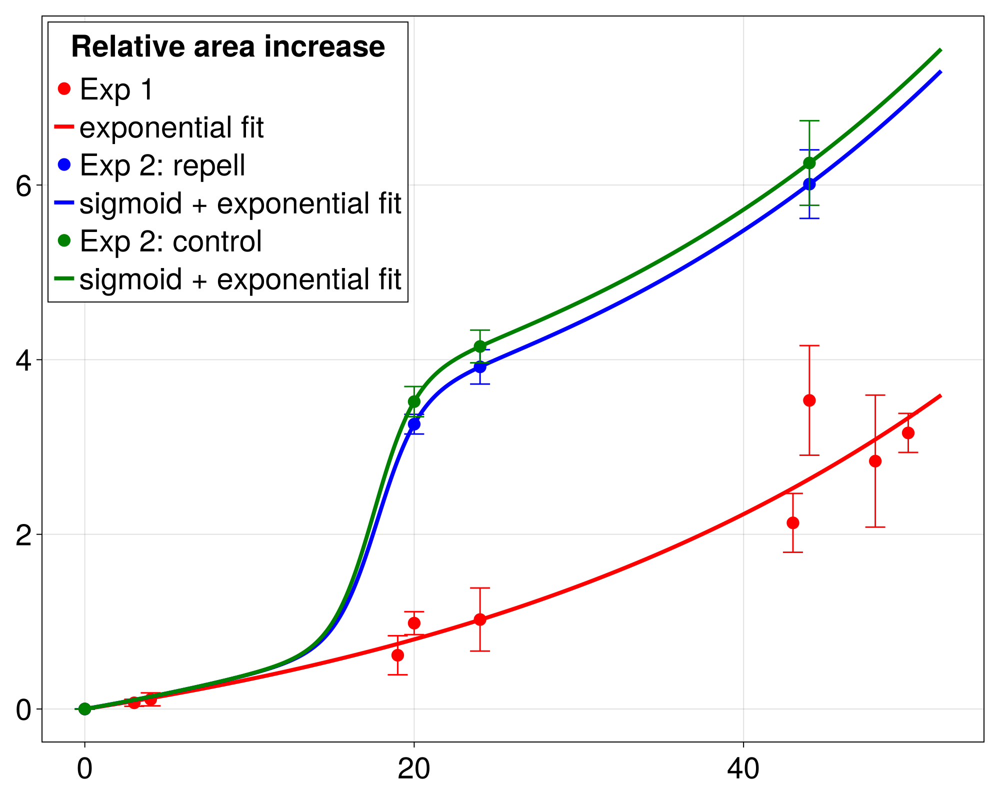

In [94]:
fig10 = Figure()

ax = Axis(fig10[1,1])
scatter!(ax,size_data.time, size_data.abs_size_normalized, color = "red", label = "Exp 1")
lines!(ax, time, y2.-1, label = "exponential fit", color = :red)
errorbars!(ax, size_data.time, size_data.abs_size_normalized, size_data.abs_size_normalized_std, color = :red)

scatter!(ax, size_data_evo_active.time, size_data_evo_active.abs_size_normalized, color = :blue, label = "Exp 2: repell")
errorbars!(ax, size_data_evo_active.time, size_data_evo_active.abs_size_normalized, size_data_evo_active.abs_size_normalized_std, color = :blue)
lines!(ax, time, y_active.-1,  color = :blue, label = "sigmoid + exponential fit")

scatter!(ax, size_data_evo_passive.time, size_data_evo_passive.abs_size_normalized, color = :green,label = "Exp 2: control")
lines!(ax, time, y_passive.-1, color = :green,label = "sigmoid + exponential fit")
errorbars!(ax, size_data_evo_passive.time, size_data_evo_passive.abs_size_normalized, size_data_evo_passive.abs_size_normalized_std, color = :green)

axislegend( "Relative area increase", position = :lt) 
save(joinpath(path,"size_evo_64.pdf"),fig10)
fig10

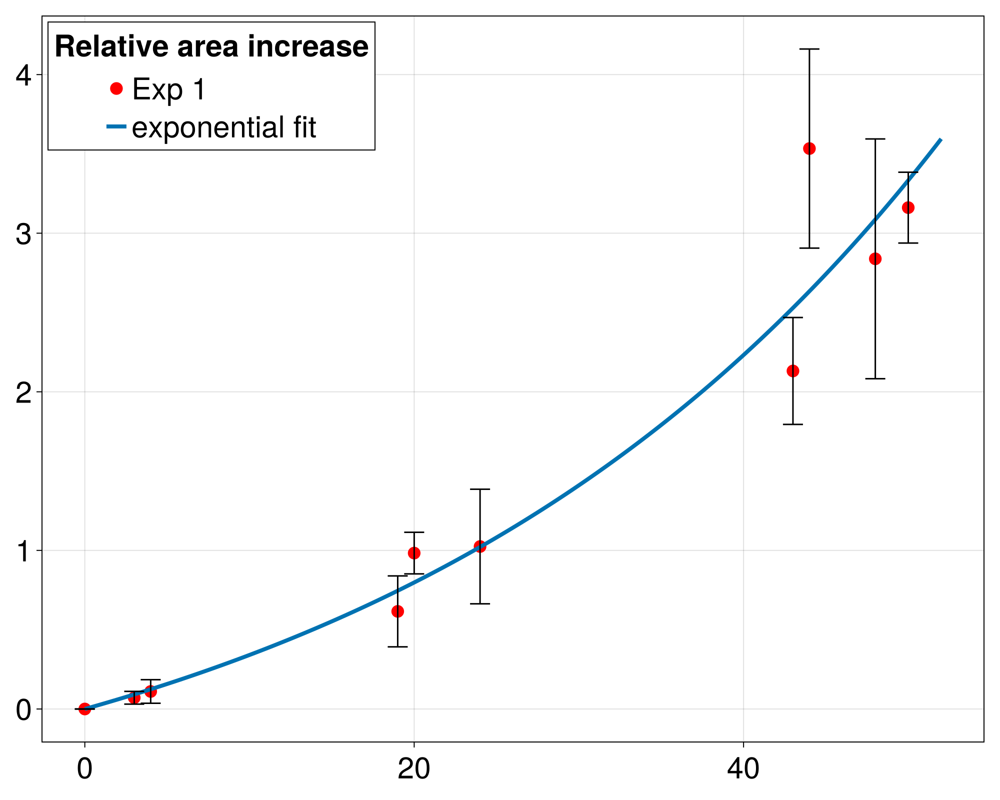

In [95]:


fig11 = Figure()

ax = Axis(fig11[1,1])
scatter!(ax,size_data.time, size_data.abs_size_normalized, color = "red", label = "Exp 1")
lines!(ax, time, y2.-1, label = "exponential fit")
errorbars!(ax, size_data.time, size_data.abs_size_normalized, size_data.abs_size_normalized_std, color = :black)
"""
scatter!(ax, size_data_evo_active.time, size_data_evo_active.abs_size_normalized, color = :blue, label = "Exp 2: repell")
errorbars!(ax, size_data_evo_active.time, size_data_evo_active.abs_size_normalized, size_data_evo_active.abs_size_normalized_std, color = :blue)
lines!(ax, time, y_active.-1,  color = :blue, label = "sigmoid + exponential fit")

scatter!(ax, size_data_evo_passive.time, size_data_evo_passive.abs_size_normalized, color = :green,label = "Exp 2: control")
lines!(ax, time, y_passive.-1, color = :green,label = "sigmoid + exponential fit")
errorbars!(ax, size_data_evo_passive.time, size_data_evo_passive.abs_size_normalized, size_data_evo_passive.abs_size_normalized_std, color = :green)
"""


axislegend( "Relative area increase", position = :lt) 
save(joinpath(path,"size_growth.png"),fig11)
fig11

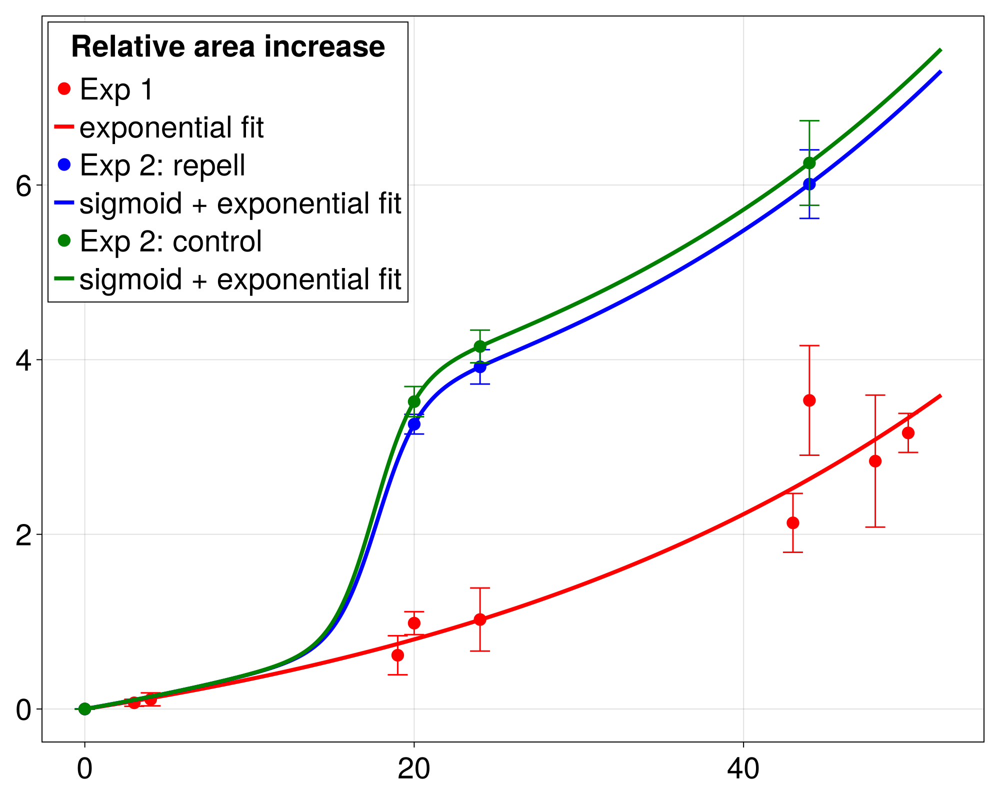

In [96]:
fig10 = Figure()

ax = Axis(fig10[1,1])
scatter!(ax,size_data.time, size_data.abs_size_normalized, color = "red", label = "Exp 1")
lines!(ax, time, y2.-1, label = "exponential fit", color = :red)
errorbars!(ax, size_data.time, size_data.abs_size_normalized, size_data.abs_size_normalized_std, color = :red)

scatter!(ax, size_data_evo_active.time, size_data_evo_active.abs_size_normalized, color = :blue, label = "Exp 2: repell")
errorbars!(ax, size_data_evo_active.time, size_data_evo_active.abs_size_normalized, size_data_evo_active.abs_size_normalized_std, color = :blue)
lines!(ax, time, y_active.-1,  color = :blue, label = "sigmoid + exponential fit")

scatter!(ax, size_data_evo_passive.time, size_data_evo_passive.abs_size_normalized, color = :green,label = "Exp 2: control")
lines!(ax, time, y_passive.-1, color = :green,label = "sigmoid + exponential fit")
errorbars!(ax, size_data_evo_passive.time, size_data_evo_passive.abs_size_normalized, size_data_evo_passive.abs_size_normalized_std, color = :green)

axislegend( "Relative area increase", position = :lt) 
save(joinpath(path,"size_evo_64.pdf"),fig10)
fig10

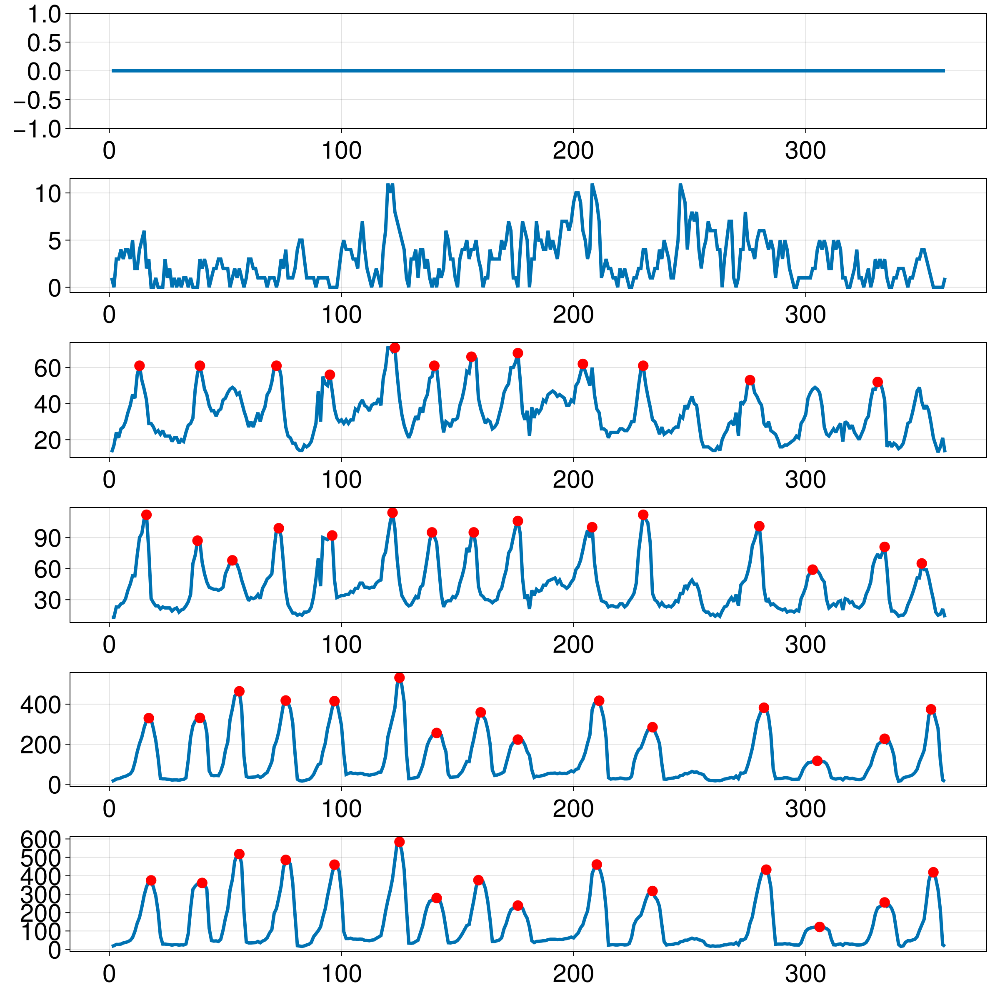

In [97]:
fig6 = Figure(size =(1200,1200))
for i in 1:6
    data1 = data_full.metric_OG[i+6];
    ax = CairoMakie.Axis(fig6[i,1])
    lines!(ax, data1)
    pkindices, properties = findpeaks1d(data1, prominence=0.6*mean(data1), distance = 4, height = 50)
    scatter!(ax, pkindices, data1[[pkindices...]],color = "red" )
end
fig6

In [98]:
peaks_full  = @chain data_full begin 
    @transform(:nr_peaks_OG = length.([findpeaks1d(i, prominence=0.4*mean(i), distance = 4, height = 40)[1] for i in :metric_OG])  )
end
first(peaks_full)

Row,data_set,colony,time,metric_OG,metric_cov,pair_OG,pair_cov,OG_size,border_points,Parameters,nr_peaks_OG
,String,String,Int64,Array…,Array…,Array…,Array…,Int64,Array…,paramete…,Int64
1,14_06_23_stacked_full_res 2024_04_16,Kolonie-1 seg.tif,0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0 … 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[54, 36, 51, 46, 47, 47, 48, 48, 46, 51 … 44, 51, 46, 47, 48, 47, 47, 46, 49, 54]","[5536, 5551, 5566, 5468, 5558, 5554, 5569, 5531, 5535, 5454 … 5430, 5578, 5541, 5593, 5476, 5592, 5440, 5658, 5467, 5695]","[5606, 5518, 5634, 5688, 5395, 5464, 5459, 5502, 5699, 5657 … 5601, 5573, 5550, 5598, 5576, 5641, 5630, 5589, 5474, 5570]",16675,"CartesianIndex{2}[CartesianIndex(1081, 630), CartesianIndex(1082, 630), CartesianIndex(1083, 630), CartesianIndex(1084, 630), CartesianIndex(1075, 631), CartesianIndex(1076, 631), CartesianIndex(1077, 631), CartesianIndex(1078, 631), CartesianIndex(1079, 631), CartesianIndex(1080, 631) … CartesianIndex(1084, 775), CartesianIndex(1085, 775), CartesianIndex(1086, 775), CartesianIndex(1087, 775), CartesianIndex(1088, 775), CartesianIndex(1089, 775), CartesianIndex(1090, 775), CartesianIndex(1091, 775), CartesianIndex(1092, 775), CartesianIndex(1093, 775)]","parameters([0.0, 4.0, 20.0, 24.0, 44.0, 48.0], 0.8, 0.8, 0.4, 360, 2000000, 300, [1644, 1588], 6, 82, [822, 794], 0.029717, #5, 0.01, [0 1 0; 1 -4 1; 0 1 0], 6, [""Kolonie-1 seg.tif"", ""Kolonie-3 seg.tif"", ""Kolonie-5 seg.tif"", ""Kolonie-6 seg.tif"", ""Kolonie-7 seg.tif"", ""Kolonie-8 seg.tif""], 2.0, [0.0, 0.124272, 0.796213, 1.01943, 2.62733, 3.07811], [0.124272, 0.67194, 0.22322, 1.6079, 0.450777], 15, 0.1, #7, 0.2, 0.995, 0.995)",0


In [99]:
peaks_over_time = @chain peaks_full begin
    groupby([:time])
    @combine(:peaks_mean = mean(:nr_peaks_OG), :peaks_stdd =std(:nr_peaks_OG) )
end


Row,time,peaks_mean,peaks_stdd
,Int64,Float64,Float64
1,0,0.0,0.0
2,3,0.375,1.06066
3,4,0.0,0.0
4,19,11.75,4.55914
5,20,14.5,1.51658
6,24,12.4138,2.82232
7,43,14.25,1.90863
8,44,13.1667,2.04124
9,48,13.0476,1.74574


In [100]:
peaks_over_time_all = @chain peaks_full begin
    groupby([:time,:data_set])
    @combine(:peaks_mean = mean(:nr_peaks_OG), :peaks_stdd =std(:nr_peaks_OG) )
end

Row,time,data_set,peaks_mean,peaks_stdd
,Int64,String,Float64,Float64
1,0,14_06_23_stacked_full_res 2024_04_16,0.0,0.0
2,4,14_06_23_stacked_full_res 2024_04_16,0.0,0.0
3,20,14_06_23_stacked_full_res 2024_04_16,14.5,1.51658
4,24,14_06_23_stacked_full_res 2024_04_16,14.8333,0.983192
5,44,14_06_23_stacked_full_res 2024_04_16,13.1667,2.04124
6,48,14_06_23_stacked_full_res 2024_04_16,12.8333,1.94079
7,0,17_05_23_stacked_full_res 2024_04_16,0.0,0.0
8,24,17_05_23_stacked_full_res 2024_04_16,12.4286,2.43975
9,48,17_05_23_stacked_full_res 2024_04_16,12.1429,1.34519


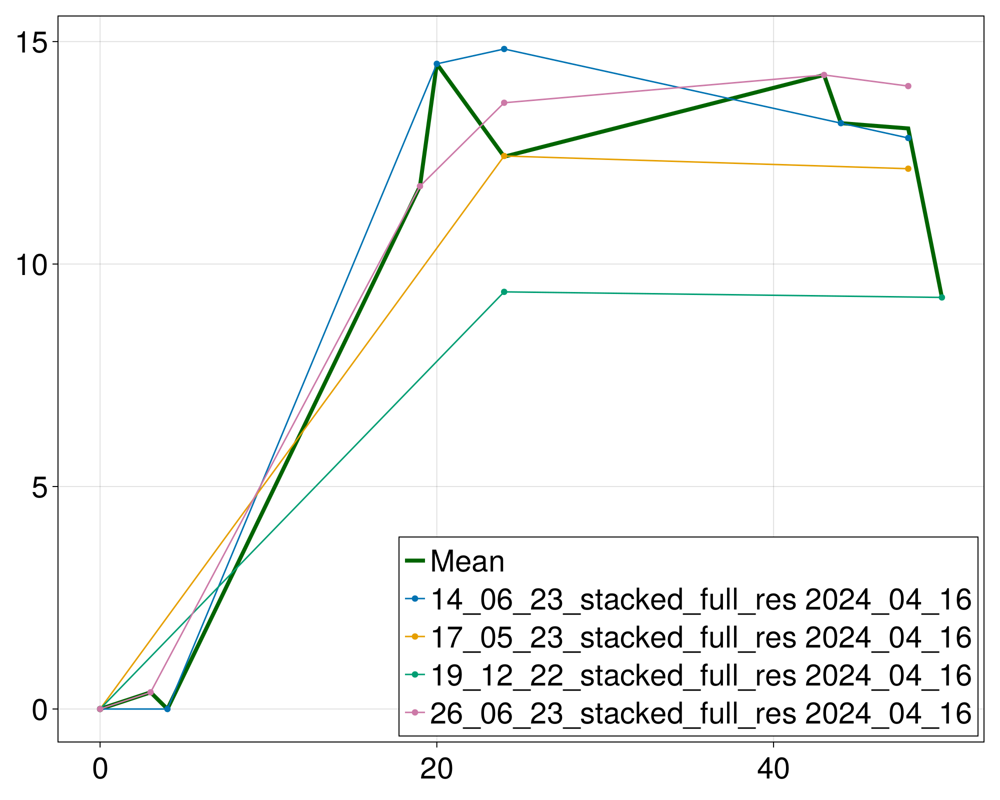

In [98]:
fig7 = lines(peaks_over_time.time,peaks_over_time.peaks_mean, color = "darkgreen", whiskerwidth = 10, label = "Mean")

for (k, i) in pairs(groupby(peaks_over_time_all,:data_set))
    scatterlines!(fig7.axis, i.time, i.peaks_mean, label = String(k.data_set))
end
axislegend(fig7.axis, position = :rb)
fig7


In [102]:
fIndex_fil = @chain df_f begin 
    @subset(:data_set .== "Daten vom 10-04-23 stacked")
    groupby(:time)
    @combine(:data_stet = :data_set[1],:fil_OG = mean(sum.(:abs_OG)), :fil_cov = mean(sum.(:abs_cov)))
end

UndefVarError: UndefVarError: `df_f` not defined